# Computer Vision 2022 Assignment 2: Image matching and retrieval

In this assignment, you will experiment with image feature detectors, descriptors and matching. There are 3 main parts to the assignment:

- matching an object in a pair of images
- searching for an object in a collection of images
- analysis and discussion of results

This assignment will have a minimum hurdle of 40%. You will fail if you can not reach the minimum hurdle.

## General instructions

As before, you will use this notebook to run your code and display your results and analysis. Again we will mark a PDF conversion of your notebook, referring to your code if necessary, so you should ensure your code output is formatted neatly. 

***When converting to PDF, include the outputs and analysis only, not your code.*** You can do this from the command line using the `nbconvert` command (installed as part of Jupyter) as follows:

    jupyter nbconvert Assignment2.ipynb --to pdf --no-input --TagRemovePreprocessor.remove_cell_tags 'remove-cell'
    # Or
    jupyter nbconvert Assignment2.ipynb --TagRemovePreprocessor.remove_cell_tags='{"remove_cell"}'

In [ ]:
!sudo apt-get install texlive-xetex texlive-fonts-recommended texlive-plain-generic

In [ ]:
!apt-get install texlive texlive-xetex texlive-latex-extra pandoc
!pip install pypandoc

In [45]:
!jupyter nbconvert /content/Assignment2_final2.ipynb --TagRemovePreprocessor.remove_cell_tags='{"remove_cell"}'

[NbConvertApp] Converting notebook /content/Assignment2_final2.ipynb to html
[NbConvertApp] Writing 25935623 bytes to /content/Assignment2_final2.html


**Please do try this ccommond early before the last day! As the commend may be a little bit difference depending on your computer and the environment.**

This will also remove the preamble text from each question. We will use the `OpenCV` library to complete the prac. It has several built in functions that will be useful. You are expected to consult documentation and use them appropriately.

This being the second assignment, we have provided less strict direction this time and you have more flexibility to choose how you answer each question. However you still need to ensure the outputs and report are clear and easy to read. This includes:

- sizing, arranging and captioning image outputs appropriately
- explaining what you have done clearly and concisely
- clearly separating answers to each question

## Data

We have provided some example images for this assignment, available through a link on the MyUni assignment page. The images are organised by subject matter, with one folder containing images of book covers, one of museum exhibits, and another of urban landmarks. Within each category, there is a “Reference” folder containing a clean image of each object and a “Query” folder containing images taken on a mobile device. Within each category, images with the same name contain the same object (so 001.jpg in the Reference folder contains the same book as 001.jpg in the Query folder).
The data is a subset of the Stanford Mobile Visual Search Dataset which is available at 

<http://web.cs.wpi.edu/~claypool/mmsys-dataset/2011/stanford/index.html>. 

The full data set contains more image categories and more query images of the objects we have provided, which may be useful for your testing!

Do not submit your own copy of the data or rename any files or folders! For marking, we will assume the datasets are available in subfolders of the working directory using the same folder names provided.

Here is some general setup code, which you can edit to suit your needs.

In [3]:
# Numpy is the main package for scientific computing with Python. 
import numpy as np
import cv2 as cv

# Matplotlib is a useful plotting library for python 
import matplotlib.pyplot as plt
# This code is to make matplotlib figures appear inline in the
# notebook rather than in a new window.
%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots, can be changed
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# Some more magic so that the notebook will reload external python modules;
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2
%reload_ext autoreload

In [4]:
def draw_outline(ref, query, model):
    """
        Draw outline of reference image in the query image.
        This is just an example to show the steps involved.
        You can modify to suit your needs.
        Inputs:
            ref: reference image
            query: query image
            model: estimated transformation from query to reference image
    """
    h,w = ref.shape[:2]
    pts = np.float32([ [0,0],[0,h-1],[w-1,h-1],[w-1,0] ]).reshape(-1,1,2)
    dst = cv.perspectiveTransform(pts,model)
    
    img = query.copy()
    new_img = cv.cvtColor(img,cv.COLOR_GRAY2RGB)
    color = (255, 0, 0)
    return cv.polylines(new_img,[np.int32(dst)],True,color,3, cv.LINE_AA)


def draw_inliers(img1, img2, kp1, kp2, matches, matchesMask):
    """
        Draw inlier between images
        img1 / img2: reference/query  img
        kp1 / kp2: their keypoints
        matches : list of (good) matches after ratio test
        matchesMask: Inlier mask returned in cv2.findHomography() 
    """
    matchesMask = matchesMask.ravel().tolist()
    draw_params = dict(matchColor = (0,255,0), # draw matches in green color
                    singlePointColor = None,
                    matchesMask = matchesMask, # draw only inliers
                    flags = 2)
    return cv.drawMatches(img1,kp1,img2,kp2,matches,None,**draw_params)

# Question 1: Matching an object in a pair of images (45%)

In this question, the aim is to accurately locate a reference object in a query image, for example:


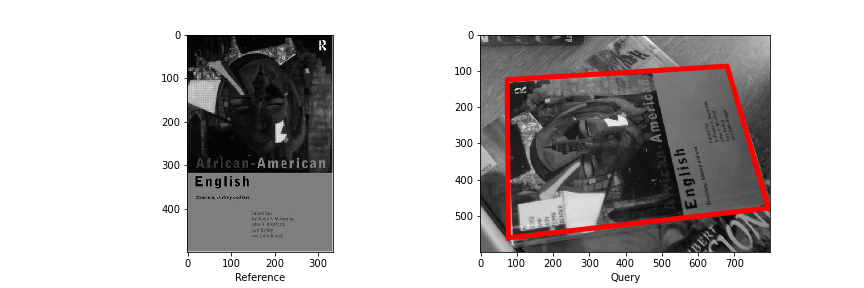

0. Download and read through the paper [ORB: an efficient alternative to SIFT or SURF](https://www.researchgate.net/publication/221111151_ORB_an_efficient_alternative_to_SIFT_or_SURF) by Rublee et al. You don't need to understand all the details, but try to get an idea of how it works. ORB combines the FAST corner detector (covered in week 4) and the BRIEF descriptor. BRIEF is based on similar ideas to the SIFT descriptor we covered week 4, but with some changes for efficiency.

1. [Load images] Load the first (reference, query) image pair from the "book_covers" category using opencv (e.g. `img=cv2.imread()`). Check the parameter option in "
cv2.imread()" to ensure that you read the gray scale image, since it is necessary for computing ORB features.

2. [Detect features] Create opencv ORB feature extractor by `orb=cv2.ORB_create()`. Then you can detect keypoints by `kp = orb.detect(img,None)`, and compute descriptors by `kp, des = orb.compute(img, kp)`. You need to do this for each image, and then you can use `cv2.drawKeypoints()` for visualization.

3. [Match features] As ORB is a binary feature, you need to use HAMMING distance for matching, e.g., `bf = cv2.BFMatcher(cv2.NORM_HAMMING)`. Then you are requried to do KNN matching (k=2) by using `bf.knnMatch()`. After that, you are required to use "ratio_test" to find good matches. By default, you can set `ratio=0.8`.

4. [Plot and analyze] You need to visualize the matches by using the `cv2.drawMatches()` function. Also you can change the ratio values, parameters in `cv2.ORB_create()`, and distance functions in `cv2.BFMatcher()`. Please discuss how these changes influence the match numbers.


In [109]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n') 



------------------------------------------------------------------------------------------------------



Secton 1.1:
The following figures will demonstrate the load image process and how the keeypoints been detected for both reference image and query image.

In [110]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n') 



------------------------------------------------------------------------------------------------------



In [5]:
def display_all(image_group, size, r, c):
    # Show image using pyplot 
    fig = plt.figure(figsize=(size, size))
    rows = r
    columns = c
    num = 1

    while image_group:
      image_node = image_group.pop(0)
      if len(image_node) == 2:
        image_content = image_node[0]
        image_caption = image_node[1]
        dimensions = str(image_content.shape)
        fig.add_subplot(rows, columns, num)
        plt.imshow(image_content)
        plt.title(image_caption + "\n" + "Dimensions" + dimensions)
        plt.axis('on')
        num+=1
      if len(image_node) == 3:
        image_content = image_node[0]
        image_caption = image_node[1]
        KeyPoints = image_node[2]
        num_kp = str(len(KeyPoints))
        dimensions = str(image_content.shape)
        fig.add_subplot(rows, columns, num)
        plt.imshow(image_content)
        plt.title(image_caption + "\n" + "Number of keypoints Detected:" + num_kp + "\n" + "Dimensions" + dimensions)
        plt.axis('on')
        num+=1
      elif len(image_node) == 4:
        image_content = image_node[0]
        image_caption = image_node[1]
        total_matches = image_node[2]
        num_total_matches = str(len(total_matches))
        good_matches = image_node[3]
        num_good_matches = str(len(good_matches))
        similarity_scores = "{0:.0%}".format(len(good_matches)/len(total_matches))
        fig.add_subplot(rows, columns, num)
        plt.imshow(image_content)
        plt.title(image_caption + "\n" + "Total matches: " + num_total_matches + "\n" + "Number of good matches: " + 
        num_good_matches + "\n" + "Similarity scores: " + similarity_scores)
        plt.axis('on')
        num+=1

In [6]:
def display_all_2(image_group, size, r, c):
     # Show image using pyplot 
    fig = plt.figure(figsize=(size, size))
    rows = r
    columns = c
    num = 1

    while image_group:
      image_node = image_group.pop(0)
      if len(image_node) == 3:
        image_content = image_node[0]
        image_caption = image_node[1]
        method = image_node[2]
        fig.add_subplot(rows, columns, num)
        plt.imshow(image_content)
        plt.title(image_caption + "\n" + "method: " + method)
        plt.axis('on')
        num+=1
      elif len(image_node) == 4:
        image_content = image_node[0]
        image_caption = image_node[1]
        outliers = str(image_node[2])
        inliers = str(image_node[3])
        fig.add_subplot(rows, columns, num)
        plt.imshow(image_content)
        plt.title(image_caption + "\n" + "Number of outliers: " + outliers + "\n" + "Number of inliers: " + inliers)
        plt.axis('on')
        num+=1
      elif len(image_node) == 6:
        image_content = image_node[0]
        image_caption = image_node[1]
        method = image_node[2]
        outliers = str(image_node[3])
        inliers = str(image_node[4])
        Inlier_Ratio = str(image_node[5])
        fig.add_subplot(rows, columns, num)
        plt.imshow(image_content)
        plt.title(image_caption + "\n" + "method: " + method + "\n" + "Number of outliers: " + outliers + "\n" + "Number of inliers: " + inliers + "\n" + "Inlier Ratio: " + Inlier_Ratio )
        plt.axis('on')
        num+=1

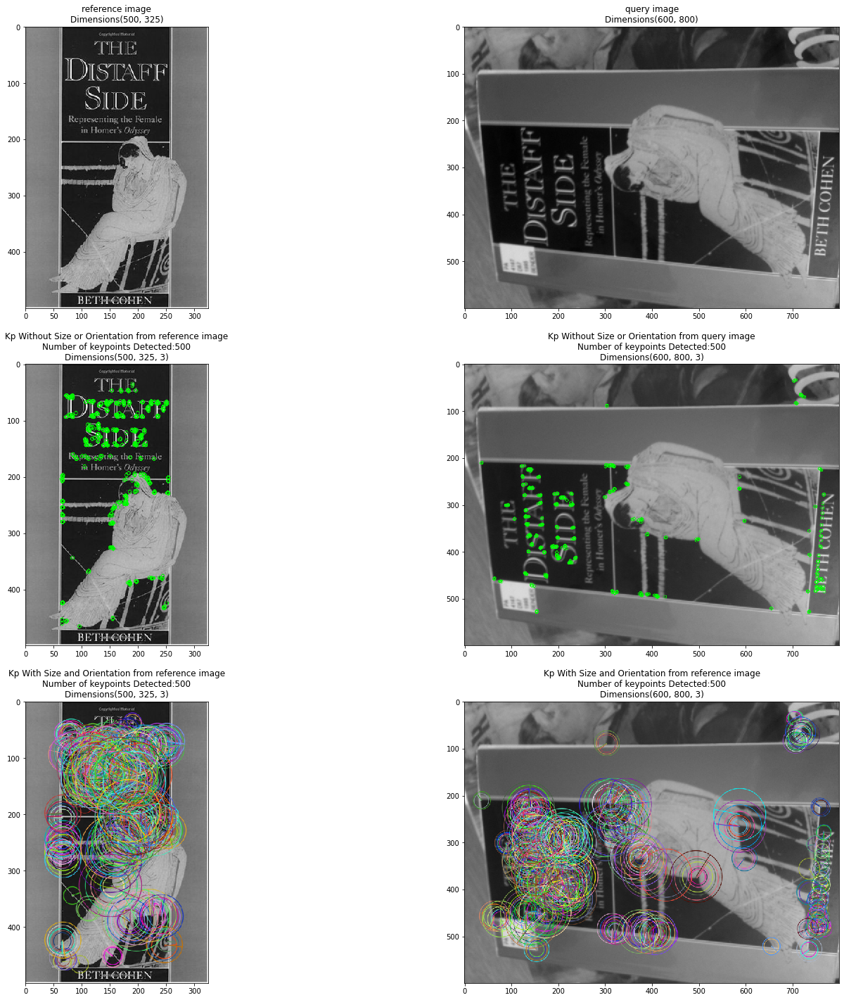

In [ ]:
# Your code for descriptor matching tests here
load_detect_kp = []
# load image at gray scale
ref_img = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/book_covers/Reference/001.jpg", 0)
que_img = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/book_covers/Query/001.jpg", 0)
load_detect_kp.append([ref_img, "reference image"])
load_detect_kp.append([que_img, "query image"])
# compute detector and descriptor
orb = cv.ORB_create()

# find the keypoints and descriptors with ORB
kp_ref = orb.detect(ref_img, None)
kp_que = orb.detect(que_img, None)

kp_ref, des_ref = orb.compute(ref_img, kp_ref)
kp_que, des_que = orb.compute(que_img, kp_que)

# draw keypoints
ref_img_kp = cv.drawKeypoints(ref_img, kp_ref, None, color=(0,255,0), flags=0)
que_img_kp = cv.drawKeypoints(que_img, kp_que, None, color=(0,255,0), flags=0)



ref_img_kp_2 = cv.drawKeypoints(ref_img, kp_ref, None, flags = cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
que_img_kp_2 = cv.drawKeypoints(que_img, kp_que, None, flags = cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
load_detect_kp.append([ref_img_kp, "Kp Without Size or Orientation from reference image", kp_ref])
load_detect_kp.append([que_img_kp, "Kp Without Size or Orientation from query image", kp_que])  

load_detect_kp.append([ref_img_kp_2, "Kp With Size and Orientation from reference image", kp_ref])
load_detect_kp.append([que_img_kp_2, "Kp With Size and Orientation from reference image", kp_que])

display_all(load_detect_kp, 25, 3, 2)

In [111]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n') 



------------------------------------------------------------------------------------------------------



What I observed:

ORB is basically the combination of two algorithms involved FAST and BRIEF where FAST stands for Features from Accelerated Segments Test whereas BRIEF stands for Binary Robust Independent Elementary Features/ ORB performs as well as SIFT on the task of feature detection (and is better than SURF) while being almost two orders of magnitude faster. ORB detector first uses FAST algorithm, this FAST algorithm finds the key points then applies Harries corner measure to find top N numbers of key points among them, this algorithm quickly selects the key points by comparing the distinctive regions like the intensity variations. The figure above has shown the key points drawn in both the reference image and query image. The simple explanation of key points is that when the human will see the image at that time the features he or she notices in that image, in the similar way when the machine reads the image it sees some points of interest known as Key points. However, FAST features do not have an orientation component and multiscale features. So orb algorithm uses a multi-scale image pyramid. Once the orb has created a pyramid it uses the fast algorithm to detect key points in the image. By detecting key points at each level orb is effectively locating key points at a different scale. 

In [112]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n') 




------------------------------------------------------------------------------------------------------



In [ ]:
ref_img = cv.imread("001_ref_book.jpg", 0)
que_img = cv.imread("001_query_book.jpg", 0)

orb = cv.ORB_create()

kp_ref, des_ref = orb.compute(ref_img, kp_ref)
kp_que, des_que = orb.compute(que_img, kp_que)

print(f'Descriptors of reference image {des_ref}')
print(f'Descriptors of query image {des_que}')
print('------------------------------')

# printing the Shape of the descriptors
print(f'Shape of descriptor of reference image {des_ref.shape}')
print(f'Shape of descriptor of query image {des_que.shape}')

Descriptors of reference image [[122  56 163 ... 100 166  82]
 [123 115 152 ...  30 138  89]
 [114  66 202 ... 112 102  10]
 ...
 [109 213  49 ...  27 196  39]
 [208  30  94 ... 128  15 217]
 [ 94 107 202 ... 243 171  83]]
Descriptors of query image [[169 125 123 ... 254 206 255]
 [118 233 104 ...  63  94  78]
 [ 41  48 247 ... 128  66 169]
 ...
 [252 111 122 ... 176 110  74]
 [  3 241 140 ...  80 131 253]
 [ 71  54 150 ... 100 234   7]]
------------------------------
Shape of descriptor of reference image (500, 32)
Shape of descriptor of query image (500, 32)


In [113]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n') 



------------------------------------------------------------------------------------------------------



What I observed:

Now the role of the BRIEF algorithm comes, Brief takes all key points found by the fast algorithm and converts them into a binary feature vector so that together they can represent an object. A binary feature vector also known as a binary feature descriptor is a feature vector that only contains 1 and 0. In brief, each keypoint is described by a feature vector which is 128–512 bits string. In the output shown above, we can see reference image descriptor shape and query image descriptor shape is (500, 32) and (500,32). So, Oriented Fast and Rotated Brief (ORB) detector tries to find 500 features in the image by default, and for each descriptor, it will describe 32 values.

In [114]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n') 



------------------------------------------------------------------------------------------------------



Section 1.2:
The following figures will demontrate image matching between two images:

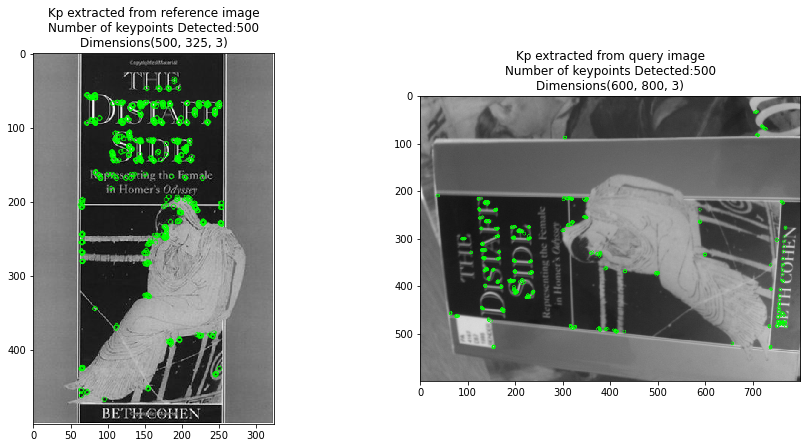

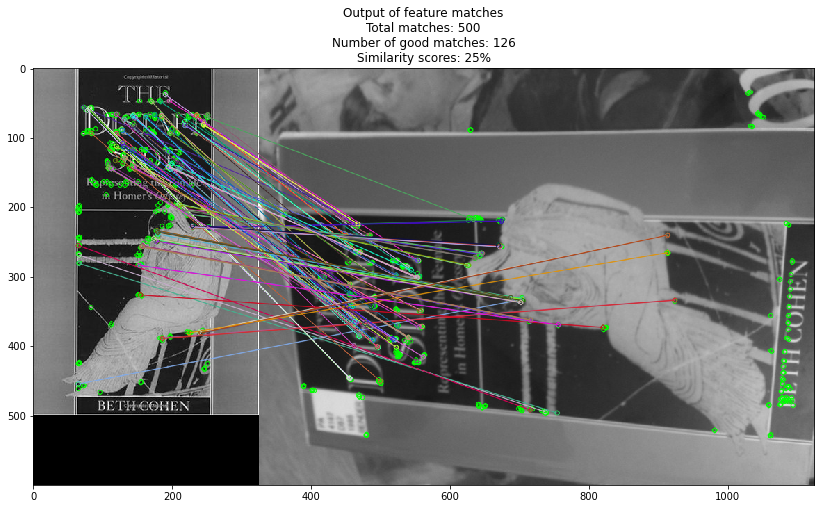

In [ ]:
ref_img = cv.imread("001_ref_book.jpg", 0)
que_img = cv.imread("001_query_book.jpg", 0)

orb = cv.ORB_create()

kp_ref = orb.detect(ref_img, None)
kp_que = orb.detect(que_img, None)

kp_ref, des_ref = orb.compute(ref_img, kp_ref)
kp_que, des_que = orb.compute(que_img, kp_que)


# draw keypoints
ref_img_kp = cv.drawKeypoints(ref_img, kp_ref, None, color=(0,255,0), flags=0)
que_img_kp = cv.drawKeypoints(que_img, kp_que, None, color=(0,255,0), flags=0)


# create BFMatcher object
matcher = cv.BFMatcher(cv.NORM_HAMMING)

# Match descriptors.
matches = matcher.knnMatch(des_ref, des_que, k=2)
# Apply ratio test
good = []
good_without_list = []
for m,n in matches:
  if m.distance < 0.8*n.distance:
    good.append([m])
    good_without_list.append(m)

img = cv.drawMatchesKnn(ref_img_kp, kp_ref, que_img_kp, kp_que, good, None, flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
kp_found = []
match_found = []
kp_found.append([ref_img_kp, "Kp extracted from reference image", kp_ref])
kp_found.append([que_img_kp, "Kp extracted from query image", kp_que])
match_found.append([img, "Output of feature matches", matches, good])
display_all(kp_found, 15, 2, 2)
display_all(match_found, 14, 1, 1)

In [115]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n') 



------------------------------------------------------------------------------------------------------



What I observed:

At this point, we already have the features of the reference image and the source image, as well as their descriptors. With these data, we can search for matches between them.
One method of matching a feature in the reference image to a feature in the source image is to use the ratio of the distance between the features and return the closest as the best match. For this purpose, Brute Force Matcher is used. Brute Force Matcher takes one descriptor of the first image and matches to all the descriptors of the second image and then it goes to the second descriptor of first image and matches to all the descriptor of the second image and so on. The brute force Matcher function takes two optional parameters. The first one is normType. It specifies the distance measurement to be used. By default, it is cv.NORM_L2. It is good for SIFT, SURF, etc (cv.NORM_L1 is also there). For binary string-based descriptors like ORB, BRIEF, BRISK, etc, cv.NORM_HAMMING should be used, which used Hamming distance as measurement. Now, We can use a Brute Force Matcher to match these descriptors together, then use the ratio test to select good matches from all matches and find how many similarities we are getting. As the figure shows above, when the ratio was set to be 0.8, the good matches selected from all matches were 126 and the similarity score is 25%.

In [116]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n') 



------------------------------------------------------------------------------------------------------



The following figures will demonstrate how the change of nfeatures which is one of the parameters from cv2.ORB_create() have effects on feature matching

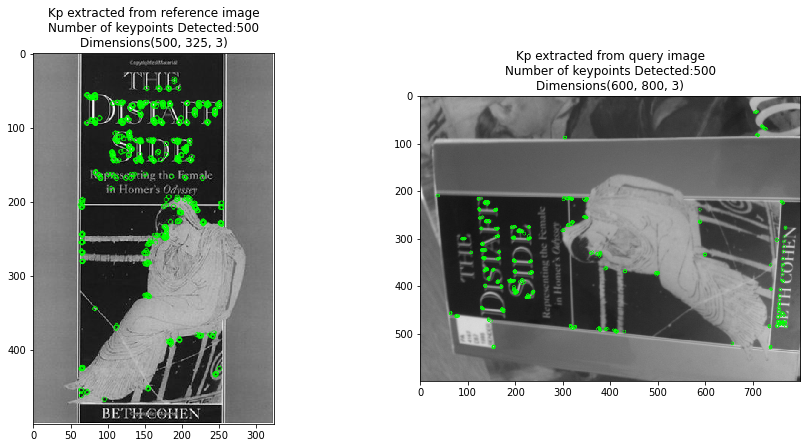

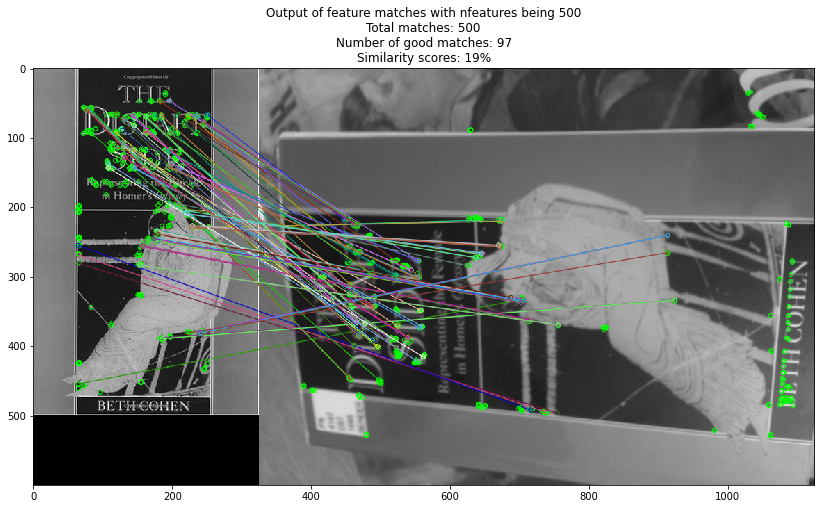

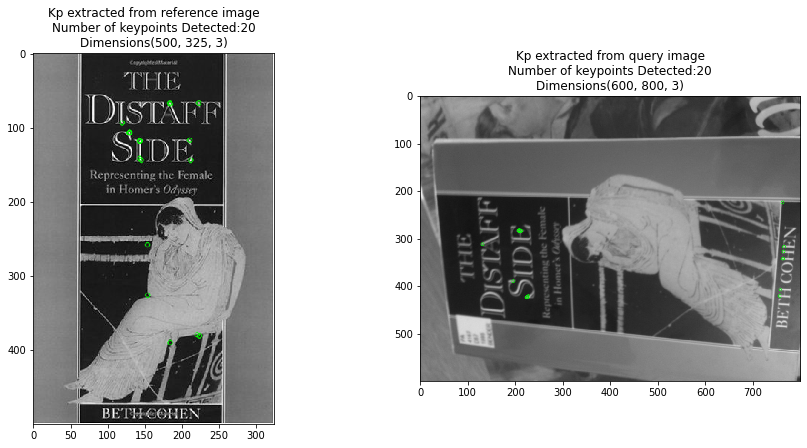

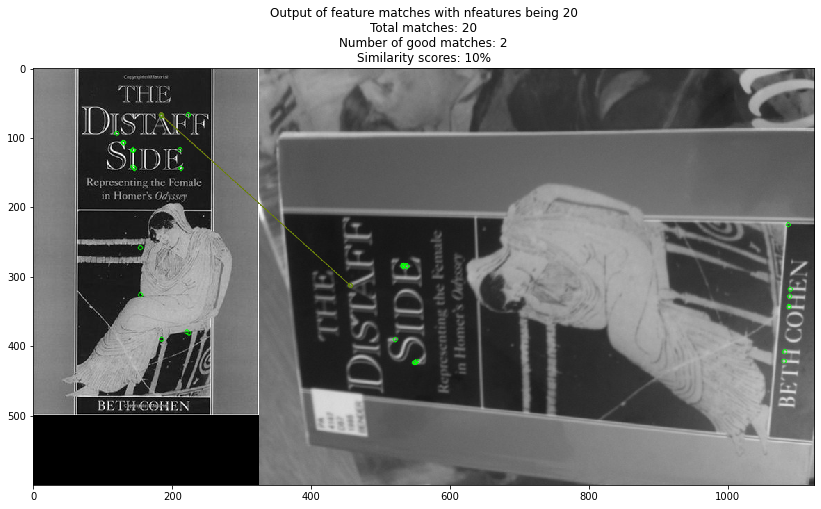

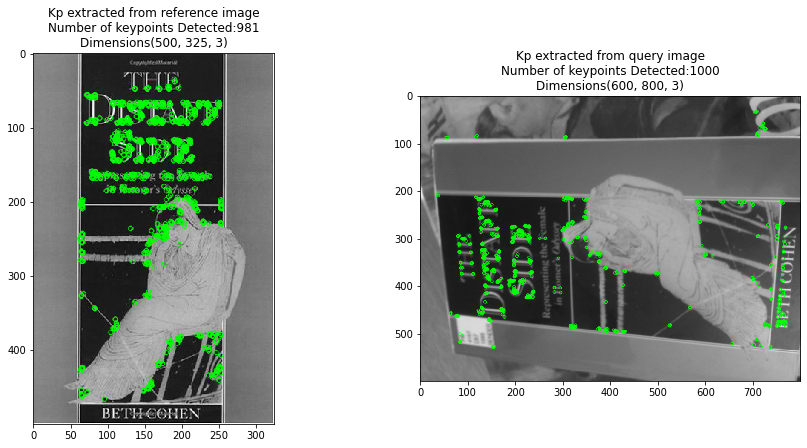

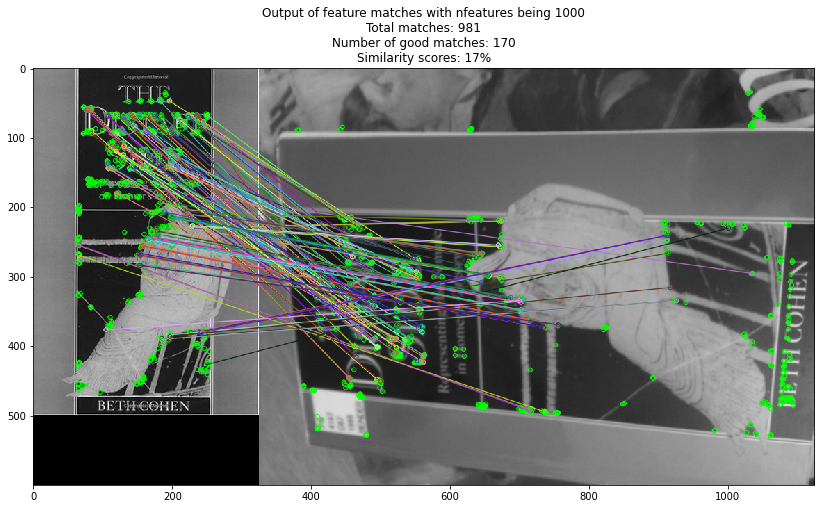

In [ ]:
ref_img = cv.imread("001_ref_book.jpg", 0)
que_img = cv.imread("001_query_book.jpg", 0)

orb = cv.ORB_create()
orb_nfeatures = cv.ORB_create(20)
orb_3 = cv.ORB_create(1000)

kp_ref = orb.detect(ref_img, None)
kp_que = orb.detect(que_img, None)

kp_ref_nf = orb_nfeatures.detect(ref_img, None)
kp_que_nf = orb_nfeatures.detect(que_img, None)

kp_ref_3 = orb_3.detect(ref_img, None)
kp_que_3 = orb_3.detect(que_img, None)

kp_ref, des_ref = orb.compute(ref_img, kp_ref)
kp_que, des_que = orb.compute(que_img, kp_que)

kp_ref_nf, des_ref_nf = orb_nfeatures.compute(ref_img, kp_ref_nf)
kp_que_nf, des_que_nf = orb_nfeatures.compute(que_img, kp_que_nf)

kp_ref_3, des_ref_3 = orb_3.compute(ref_img, kp_ref_3)
kp_que_3, des_que_3 = orb_3.compute(que_img, kp_que_3)

# draw keypoints
ref_img_kp = cv.drawKeypoints(ref_img, kp_ref, None, color=(0,255,0), flags=0)
que_img_kp = cv.drawKeypoints(que_img, kp_que, None, color=(0,255,0), flags=0)

ref_img_kp_nf = cv.drawKeypoints(ref_img, kp_ref_nf, None, color=(0,255,0), flags=0)
que_img_kp_nf = cv.drawKeypoints(que_img, kp_que_nf, None, color=(0,255,0), flags=0)

ref_img_kp_3 = cv.drawKeypoints(ref_img, kp_ref_3, None, color=(0,255,0), flags=0)
que_img_kp_3 = cv.drawKeypoints(que_img, kp_que_3, None, color=(0,255,0), flags=0)

# create BFMatcher object
matcher = cv.BFMatcher(cv.NORM_HAMMING)

# Match descriptors.
matches = matcher.knnMatch(des_ref, des_que, k=2)
matches_nf = matcher.knnMatch(des_ref_nf, des_que_nf, k=2)
matches_3 = matcher.knnMatch(des_ref_3, des_que_3, k=2)
# Apply ratio test
good = []
good_without_list = []
for m,n in matches:
  if m.distance < 0.75*n.distance:
    good.append([m])
    good_without_list.append(m)

img = cv.drawMatchesKnn(ref_img_kp, kp_ref, que_img_kp, kp_que, good, None, flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
kp_found = []
match_found = []
kp_found.append([ref_img_kp, "Kp extracted from reference image", kp_ref])
kp_found.append([que_img_kp, "Kp extracted from query image", kp_que])
match_found.append([img, "Output of feature matches with nfeatures being 500", matches, good])
display_all(kp_found, 15, 2, 2)
display_all(match_found, 14, 1, 1)

similary = len(good)/len(matches)
# draw matches
#plt.imshow(img), plt.show()

good_nf = []
good_without_list_nf = []
for m,n in matches_nf:
  if m.distance < 0.75*n.distance:
    good_nf.append([m])
    good_without_list_nf.append(m)

img_nf = cv.drawMatchesKnn(ref_img_kp_nf, kp_ref_nf, que_img_kp_nf, kp_que_nf, good_nf, None, flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
kp_found_nf = []
match_found_nf = []
kp_found_nf.append([ref_img_kp_nf, "Kp extracted from reference image", kp_ref_nf])
kp_found_nf.append([que_img_kp_nf, "Kp extracted from query image", kp_que_nf])
match_found_nf.append([img_nf, "Output of feature matches with nfeatures being 20", matches_nf, good_nf])
display_all(kp_found_nf, 15, 2, 2)
display_all(match_found_nf, 14, 1, 1)

good_3 = []
good_without_list_3 = []
for m,n in matches_3:
  if m.distance < 0.75*n.distance:
    good_3.append([m])
    good_without_list_3.append(m)


img_3 = cv.drawMatchesKnn(ref_img_kp_3, kp_ref_3, que_img_kp_3, kp_que_3, good_3, None, flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
kp_found_3 = []
match_found_3 = []
kp_found_3.append([ref_img_kp_3, "Kp extracted from reference image", kp_ref_3])
kp_found_3.append([que_img_kp_3, "Kp extracted from query image", kp_que_3])
match_found_3.append([img_3, "Output of feature matches with nfeatures being 1000", matches_3, good_3])
display_all(kp_found_3, 15, 2, 2)
display_all(match_found_3, 14, 1, 1)

In [117]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n') 



------------------------------------------------------------------------------------------------------



What I observed:

One parameter from cv2.ORB_create() is nfeatures which describes the maximum number of features to retain. Different similarity scores of
feature matches can be obtained by varying the number of nfeatures. As 
the figures show above, three different nfeatures were used which are 
500, 20, and 1000, and the similarity scores for each of them are 
19%, 10%, and 17% respectively. Hence, a conclusion can be found by
analyzing the difference between the 3 figures: the number of nfeatures around 500 will provide the highest similarity for feature matching. 

In [118]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n') 



------------------------------------------------------------------------------------------------------



The following figures will demonstrate how the change of scaleFactor which is one of the parameters from cv2.ORB_create() have effects on feature matching

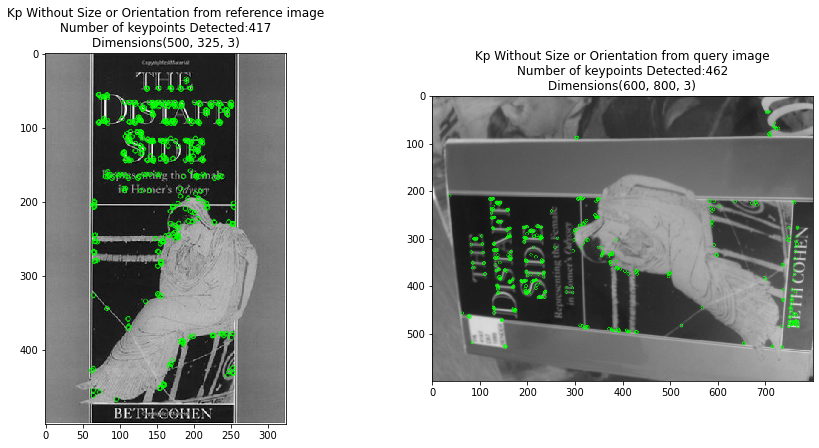

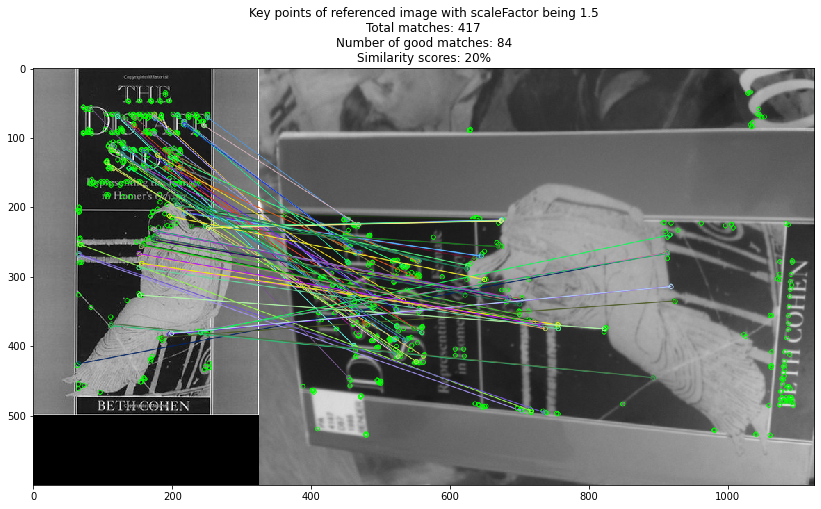

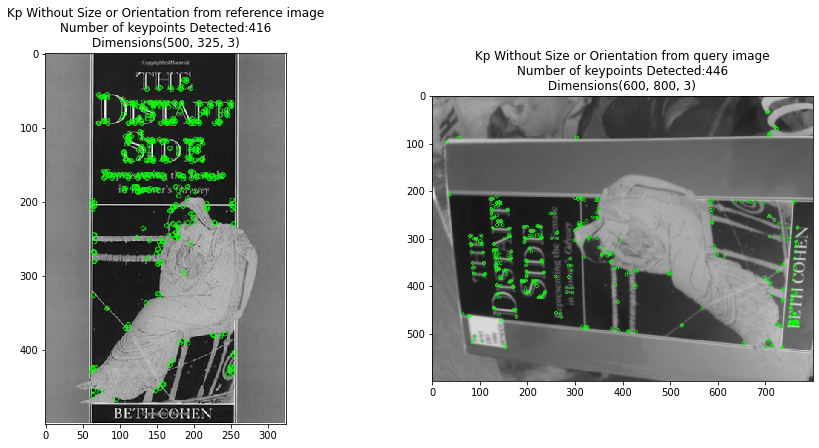

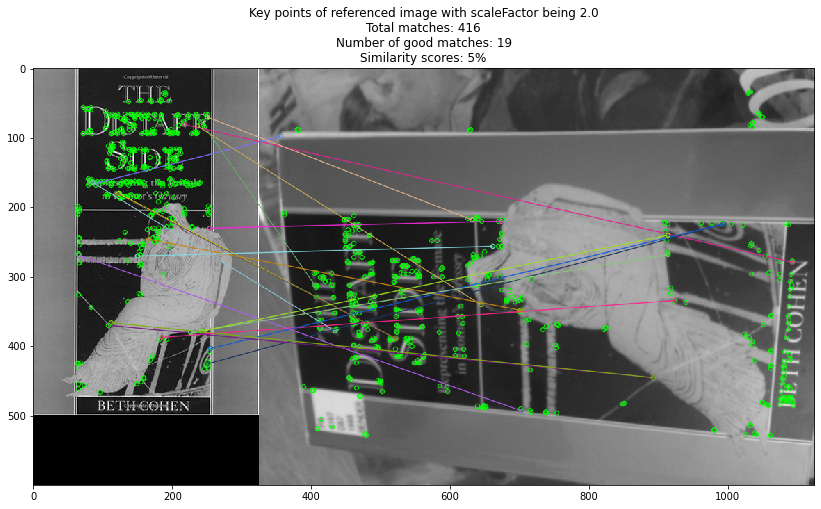

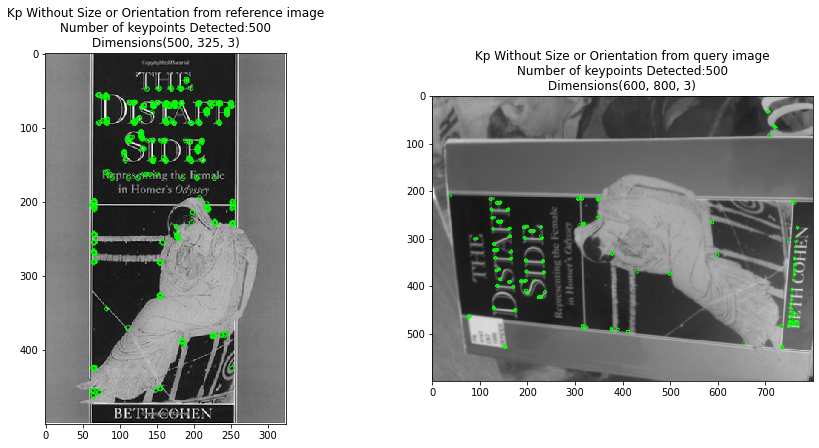

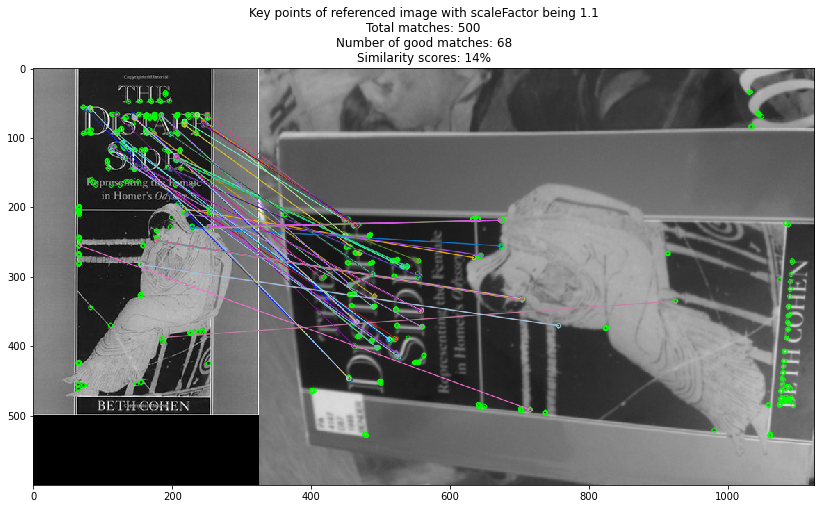

In [ ]:
ref_img = cv.imread("001_ref_book.jpg", 0)
que_img = cv.imread("001_query_book.jpg", 0)

orb = cv.ORB_create(scaleFactor = 1.5)
orb_nfeatures = cv.ORB_create(scaleFactor = 2)
orb_nfeatures_2 = cv.ORB_create(scaleFactor = 1.1)

kp_ref = orb.detect(ref_img, None)
kp_que = orb.detect(que_img, None)

kp_ref_nf = orb_nfeatures.detect(ref_img, None)
kp_que_nf = orb_nfeatures.detect(que_img, None)

kp_ref_nf_2 = orb_nfeatures_2.detect(ref_img, None)
kp_que_nf_2 = orb_nfeatures_2.detect(que_img, None)

kp_ref, des_ref = orb.compute(ref_img, kp_ref)
kp_que, des_que = orb.compute(que_img, kp_que)

kp_ref_nf, des_ref_nf = orb_nfeatures.compute(ref_img, kp_ref_nf)
kp_que_nf, des_que_nf = orb_nfeatures.compute(que_img, kp_que_nf)

kp_ref_nf_2, des_ref_nf_2 = orb_nfeatures_2.compute(ref_img, kp_ref_nf_2)
kp_que_nf_2, des_que_nf_2 = orb_nfeatures_2.compute(que_img, kp_que_nf_2)

# draw keypoints
ref_img_kp = cv.drawKeypoints(ref_img, kp_ref, None, color=(0,255,0), flags=0)
que_img_kp = cv.drawKeypoints(que_img, kp_que, None, color=(0,255,0), flags=0)

ref_img_kp_nf = cv.drawKeypoints(ref_img, kp_ref_nf, None, color=(0,255,0), flags=0)
que_img_kp_nf = cv.drawKeypoints(que_img, kp_que_nf, None, color=(0,255,0), flags=0)

ref_img_kp_nf_2 = cv.drawKeypoints(ref_img, kp_ref_nf_2, None, color=(0,255,0), flags=0)
que_img_kp_nf_2 = cv.drawKeypoints(que_img, kp_que_nf_2, None, color=(0,255,0), flags=0)



# create BFMatcher object
matcher = cv.BFMatcher(cv.NORM_HAMMING)

# Match descriptors.
matches = matcher.knnMatch(des_ref, des_que, k=2)
matches_nf = matcher.knnMatch(des_ref_nf, des_que_nf, k=2)
matches_nf_2 = matcher.knnMatch(des_ref_nf_2, des_que_nf_2, k=2)
# Apply ratio test
good = []
good_without_list = []
for m,n in matches:
  if m.distance < 0.75*n.distance:
    good.append([m])
    good_without_list.append(m)

img = cv.drawMatchesKnn(ref_img_kp, kp_ref, que_img_kp, kp_que, good, None, flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
kp_found = []
match_found = []
kp_found.append([ref_img_kp, "Kp Without Size or Orientation from reference image", kp_ref])
kp_found.append([que_img_kp, "Kp Without Size or Orientation from query image", kp_que])
match_found.append([img, "Key points of referenced image with scaleFactor being 1.5", matches, good])
display_all(kp_found, 15, 2, 2)
display_all(match_found, 14, 1, 1)

similary = len(good)/len(matches)
# draw matches
#plt.imshow(img), plt.show()

good_nf = []
good_without_list_nf = []
for m,n in matches_nf:
  if m.distance < 0.75*n.distance:
    good_nf.append([m])
    good_without_list_nf.append(m)

img_nf = cv.drawMatchesKnn(ref_img_kp_nf, kp_ref_nf, que_img_kp_nf, kp_que_nf, good_nf, None, flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
kp_found_nf = []
match_found_nf = []
kp_found_nf.append([ref_img_kp_nf, "Kp Without Size or Orientation from reference image", kp_ref_nf])
kp_found_nf.append([que_img_kp_nf, "Kp Without Size or Orientation from query image", kp_que_nf])
match_found_nf.append([img_nf, "Key points of referenced image with scaleFactor being 2.0", matches_nf, good_nf])
display_all(kp_found_nf, 15, 2, 2)
display_all(match_found_nf, 14, 1, 1)

good_nf_2 = []
good_without_list_nf_2 = []
for m,n in matches_nf_2:
  if m.distance < 0.75*n.distance:
    good_nf_2.append([m])
    good_without_list_nf_2.append(m)

img_nf_2 = cv.drawMatchesKnn(ref_img_kp_nf_2, kp_ref_nf_2, que_img_kp_nf_2, kp_que_nf_2, good_nf_2, None, flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
kp_found_nf_2 = []
match_found_nf_2 = []
kp_found_nf_2.append([ref_img_kp_nf_2, "Kp Without Size or Orientation from reference image", kp_ref_nf_2])
kp_found_nf_2.append([que_img_kp_nf_2, "Kp Without Size or Orientation from query image", kp_que_nf_2])
match_found_nf_2.append([img_nf_2, "Key points of referenced image with scaleFactor being 1.1", matches_nf_2, good_nf_2])
display_all(kp_found_nf_2, 15, 2, 2)
display_all(match_found_nf_2, 14, 1, 1)

In [119]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n') 



------------------------------------------------------------------------------------------------------



What I observed:

One parameter from cv2.ORB_create() is scaleFactor which describes the Pyramid decimation ratio, greater than 1. scaleFactor==2 means the classical pyramid, where each next level has 4x fewer pixels than the previous, but such a big scale factor will degrade feature matching scores dramatically. On the other hand, too close to 1 scale factor will mean that to cover a certain scale range you will need more pyramid levels and so the speed will suffer. Different similarity scores for
feature matches were obtained by varying the scaleFactor. As 
the figures show above, two different scaleFactor were used which are 
1.5 and 2 and 1.1, feature matching scores are 20%. 5% and 14% respectively. These scores verified our assumptions above. 

In [120]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n') 



------------------------------------------------------------------------------------------------------



The following figures will demonstrate how the change of matching strategy have effects on image matching

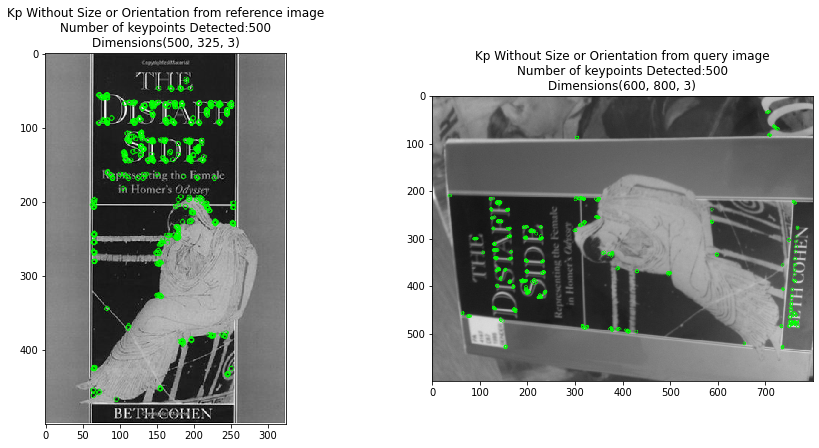

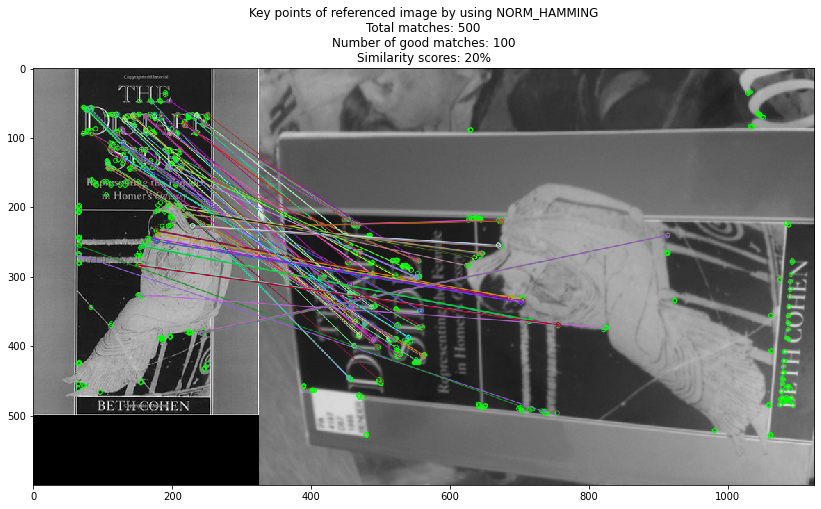

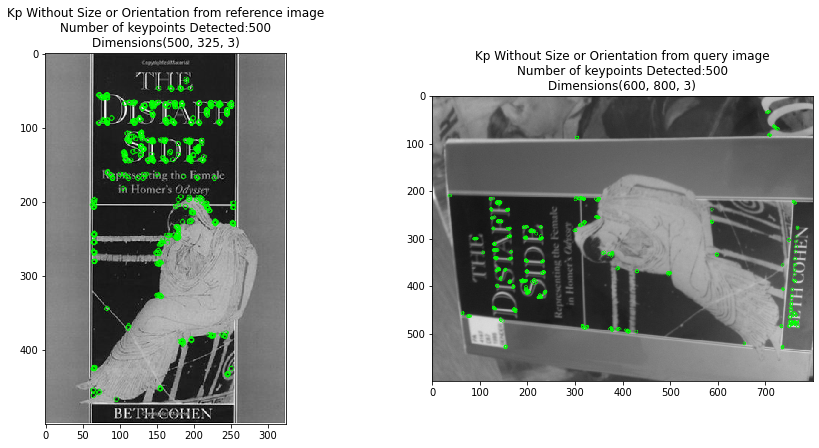

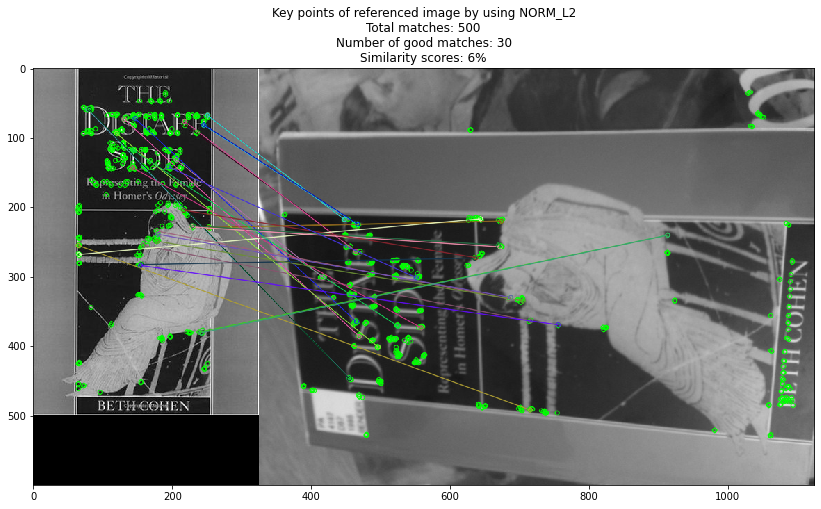

In [150]:
ref_img = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/book_covers/Reference/001.jpg", 0)
que_img = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/book_covers/Query/001.jpg", 0)

orb = cv.ORB_create()
orb_nfeatures = cv.ORB_create()

kp_ref = orb.detect(ref_img, None)
kp_que = orb.detect(que_img, None)

kp_ref_nf = orb_nfeatures.detect(ref_img, None)
kp_que_nf = orb_nfeatures.detect(que_img, None)

kp_ref, des_ref = orb.compute(ref_img, kp_ref)
kp_que, des_que = orb.compute(que_img, kp_que)

kp_ref_nf, des_ref_nf = orb_nfeatures.compute(ref_img, kp_ref_nf)
kp_que_nf, des_que_nf = orb_nfeatures.compute(que_img, kp_que_nf)

# draw keypoints
ref_img_kp = cv.drawKeypoints(ref_img, kp_ref, None, color=(0,255,0), flags=0)
que_img_kp = cv.drawKeypoints(que_img, kp_que, None, color=(0,255,0), flags=0)

ref_img_kp_nf = cv.drawKeypoints(ref_img, kp_ref_nf, None, color=(0,255,0), flags=0)
que_img_kp_nf = cv.drawKeypoints(que_img, kp_que_nf, None, color=(0,255,0), flags=0)


# create BFMatcher object
matcher = cv.BFMatcher(cv.NORM_HAMMING)
matcher_2 = cv.BFMatcher(cv.NORM_L2)

# Match descriptors.
matches = matcher.knnMatch(des_ref, des_que, k=2)
matches_nf = matcher_2.knnMatch(des_ref_nf, des_que_nf, k=2)
# Apply ratio test
good = []
good_without_list = []
for m,n in matches:
  if m.distance < 0.75*n.distance:
    good.append([m])
    good_without_list.append(m)

img = cv.drawMatchesKnn(ref_img_kp, kp_ref, que_img_kp, kp_que, good, None, flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
kp_found = []
match_found = []
kp_found.append([ref_img_kp, "Kp Without Size or Orientation from reference image", kp_ref])
kp_found.append([que_img_kp, "Kp Without Size or Orientation from query image", kp_que])
match_found.append([img, "Key points of referenced image by using NORM_HAMMING", matches, good])
display_all(kp_found, 15, 2, 2)
display_all(match_found, 14, 1, 1)

similary = len(good)/len(matches)
# draw matches
#plt.imshow(img), plt.show()

good_nf = []
good_without_list_nf = []
for m,n in matches_nf:
  if m.distance < 0.75*n.distance:
    good_nf.append([m])
    good_without_list_nf.append(m)

img_nf = cv.drawMatchesKnn(ref_img_kp_nf, kp_ref_nf, que_img_kp_nf, kp_que_nf, good_nf, None, flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
kp_found_nf = []
match_found_nf = []
kp_found_nf.append([ref_img_kp_nf, "Kp Without Size or Orientation from reference image", kp_ref_nf])
kp_found_nf.append([que_img_kp_nf, "Kp Without Size or Orientation from query image", kp_que_nf])
match_found_nf.append([img_nf, "Key points of referenced image by using NORM_L2", matches_nf, good_nf])
display_all(kp_found_nf, 15, 2, 2)
display_all(match_found_nf, 14, 1, 1)

In [121]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')



------------------------------------------------------------------------------------------------------



What I observed:

Brute-Force matcher takes the descriptor of one feature in the first set and is matched with all other features in the second set using some distance calculation. And the closest one is returned. The first parameter in cv2.BFMatcher() specifies the distance measurement to be used. As the figures show above, two different distance functions are used which are cv2.NORM_L2 and cv2.NORM_HAMMING and their feature matching scores are 19% and 6% respectively.

In [122]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')



------------------------------------------------------------------------------------------------------



3. Estimate a homography transformation based on the matches, using `cv2.findHomography()`. Display the transformed outline of the first reference book cover image on the query image, to see how well they match.

    - We provide a function `draw_outline()` to help with the display, but you may need to edit it for your needs.
    - Try the 'least squre method' option to compute homography, and visualize the inliers by using `cv2.drawMatches()`. Explain your results.
    - Again, you don't need to compare results numerically at this stage. Comment on what you observe visually.

In [123]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')



------------------------------------------------------------------------------------------------------



The following figures will demontrate how to use the 'least squre method' option to compute homography

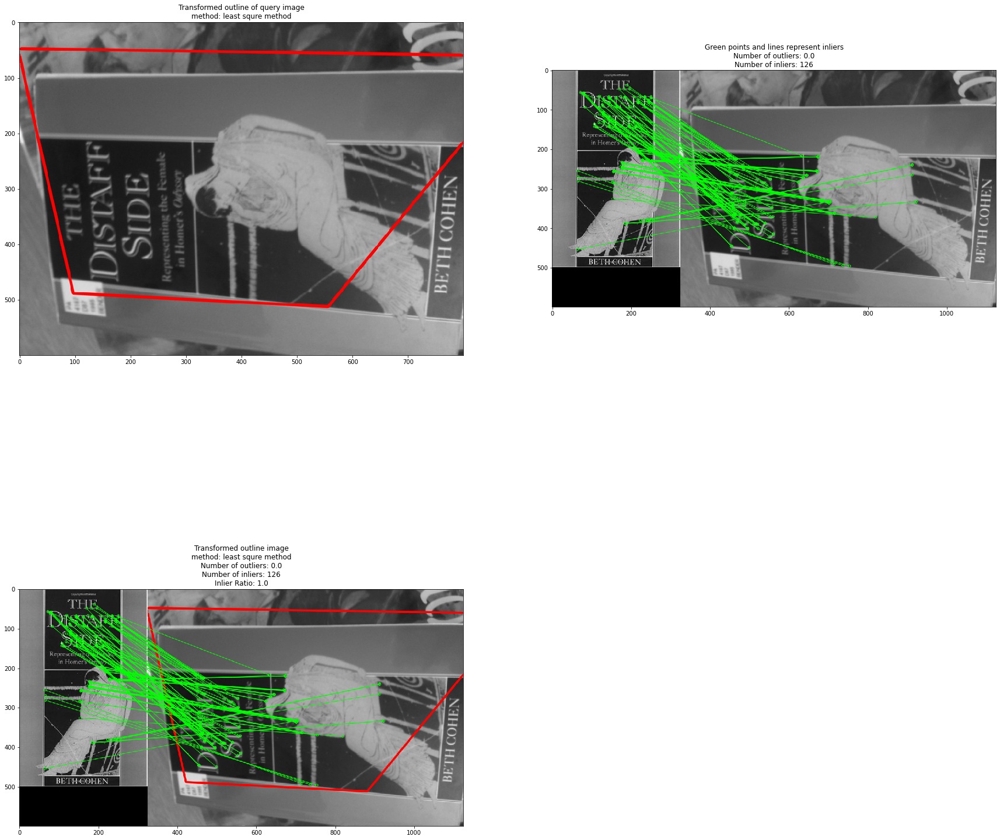

In [28]:
# Your code to display book location here
ref_img = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/book_covers/Reference/001.jpg", 0)
que_img = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/book_covers/Query/001.jpg", 0)

orb = cv.ORB_create()

kp_ref = orb.detect(ref_img, None)
kp_que = orb.detect(que_img, None)

kp_ref, des_ref = orb.compute(ref_img, kp_ref)
kp_que, des_que = orb.compute(que_img, kp_que)


# draw keypoints
ref_img_kp = cv.drawKeypoints(ref_img, kp_ref, None, color=(0,255,0), flags=0)
que_img_kp = cv.drawKeypoints(que_img, kp_que, None, color=(0,255,0), flags=0)


# create BFMatcher object
matcher = cv.BFMatcher(cv.NORM_HAMMING)

# Match descriptors.
matches = matcher.knnMatch(des_ref, des_que, k=2)
# Apply ratio test
good = []
good_without_list = []
for m,n in matches:
  if m.distance < 0.8*n.distance:
    good.append([m])
    good_without_list.append(m)

MIN_MATCH_COUNT = 10
if len(good_without_list)>MIN_MATCH_COUNT:
        src_pts = np.float32([ kp_ref[m.queryIdx].pt for m in good_without_list ]).reshape(-1,1,2)
        dst_pts = np.float32([ kp_que[m.trainIdx].pt for m in good_without_list ]).reshape(-1,1,2)

# using regular method (cv2.findHomography)
M, mask = cv.findHomography(src_pts, dst_pts)
#number of detected outliers: 
num_outliers = len(mask) - np.sum(mask)
#number of detected inliers: 
num_inliers = np.sum(mask)
#Inlier Ratio, number of inlier/number of matches: 
Inlier_Ratio = float(np.sum(mask)) / float(len(mask))

img_matching = []
# draw outline
outline_img = draw_outline(ref_img, que_img, M)

img_matching.append([outline_img, "Transformed outline of query image", "least squre method"])
# draw inliers

inliers_img = draw_inliers(ref_img, que_img, kp_ref, kp_que, good_without_list, mask)
img_matching.append([inliers_img, "Green points and lines represent inliers", num_outliers, num_inliers])
comb_img = draw_inliers(ref_img, outline_img, kp_ref, kp_que, good_without_list, mask)
img_matching.append([comb_img, "Transformed outline image", "least squre method", num_outliers, num_inliers, Inlier_Ratio])

display_all_2(img_matching, 30, 2, 2)

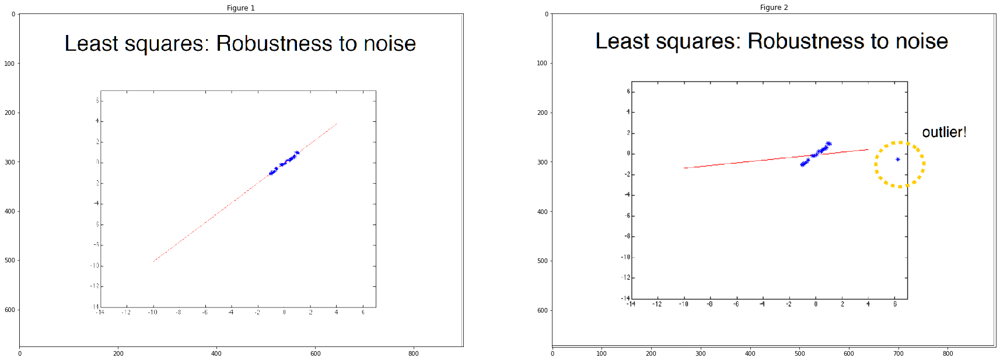

In [ ]:
def display_LSM(image_group, size, r, c):
    # Show image using pyplot 
    fig = plt.figure(figsize=(size, size))
    rows = r
    columns = c
    num = 1

    while image_group:
      image_node = image_group.pop(0)
      image_content = image_node[0]
      image_caption = image_node[1]
      fig.add_subplot(rows, columns, num)
      plt.imshow(image_content)
      plt.title(image_caption)
      plt.axis('on')
      num+=1

LSM_list = []
LSM = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/cv1.png")
LSM_list.append([LSM, "Figure 1"])

LSM_2 = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/cv2.png")
LSM_list.append([LSM_2, "Figure 2"])

display_LSM(LSM_list, 30, 1, 2)

In [125]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')



------------------------------------------------------------------------------------------------------



What I observed:

In the figures shown above, the least square method was used to compute
homography. The least-squares method is a statistical procedure to find the best fit for a set of data points by minimizing the sum of the offsets or residuals of points from the plotted curve. Least squares regression is used to predict the behavior of dependent variables and it provides the overall rationale for the placement of the line of best fit among the data points being studied. The least-squares methods can work well when the data are noisy. Figure 1 shows the result of a simulation where we used the least square to fit all the red points with a line. However, the least square is in general not very robust to the presence of
outliers as the result shown in figure 2 demonstrates. The outlier marked in blue significantly alters the quality of the fitting process. This is also reflected in our book image matching. Because the Least square method is penalized by the squared distances to the line, the outliers can have a
huge penalty and this can drive the estimated solution away from the correct solution, that's why the red box cannot exactly cover the query book shape. 

In [126]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')



------------------------------------------------------------------------------------------------------



The following figures will show the result of trying the RANSAC option to compute homography.

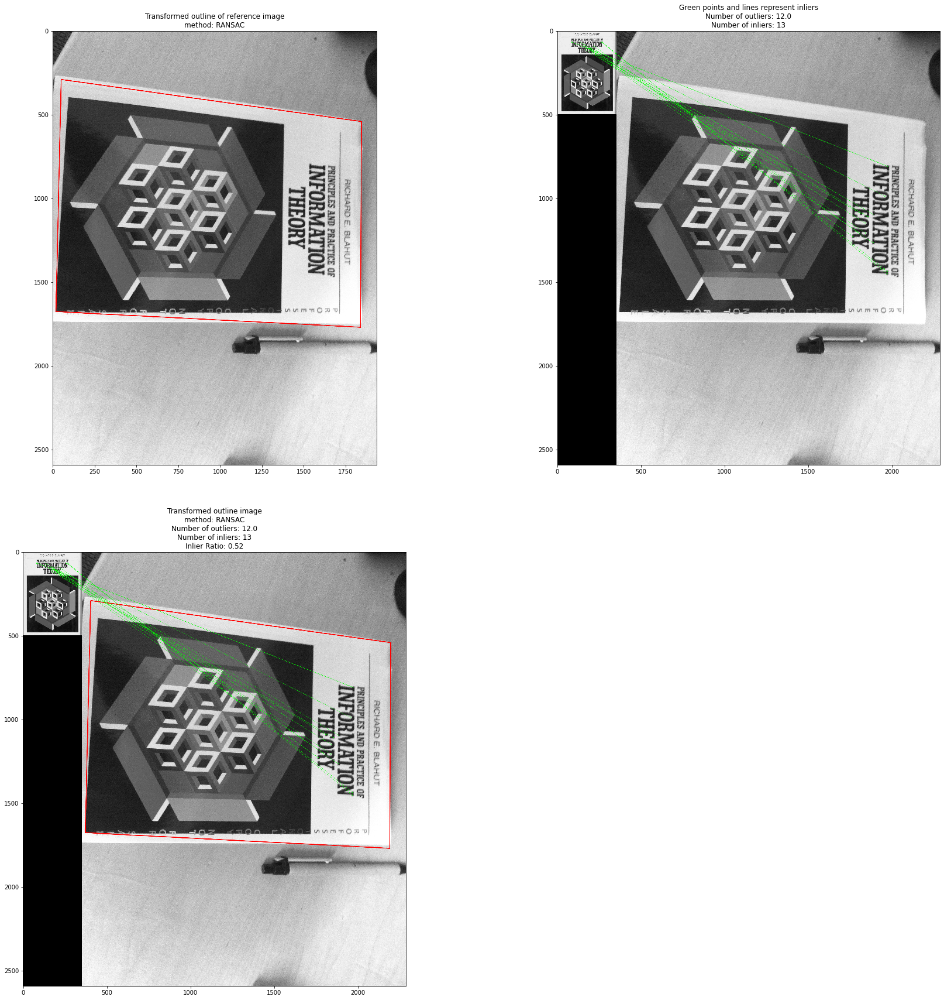

In [27]:
# Your code to display book location after RANSAC here
M, mask = cv.findHomography(src_pts, dst_pts, cv.RANSAC,5.0)
draw_outline(ref_img, que_img, M)
draw_inliers(ref_img, que_img, kp_ref, kp_que, good_without_list, mask)
#number of detected outliers: 
num_outliers = len(mask) - np.sum(mask)
#number of detected inliers: 
num_inliers = np.sum(mask)
#Inlier Ratio, number of inlier/number of matches: 
Inlier_Ratio = float(np.sum(mask)) / float(len(mask))

img_matching = []
# draw outline
outline_img = draw_outline(ref_img, que_img, M)

img_matching.append([outline_img, "Transformed outline of reference image", "RANSAC"])
# draw inliers

inliers_img = draw_inliers(ref_img, que_img, kp_ref, kp_que, good_without_list, mask)
img_matching.append([inliers_img, "Green points and lines represent inliers", num_outliers, num_inliers])
comb_img = draw_inliers(ref_img, outline_img, kp_ref, kp_que, good_without_list, mask)
img_matching.append([comb_img, "Transformed outline image", "RANSAC", num_outliers, num_inliers, Inlier_Ratio])

display_all_2(img_matching, 30, 2, 2)

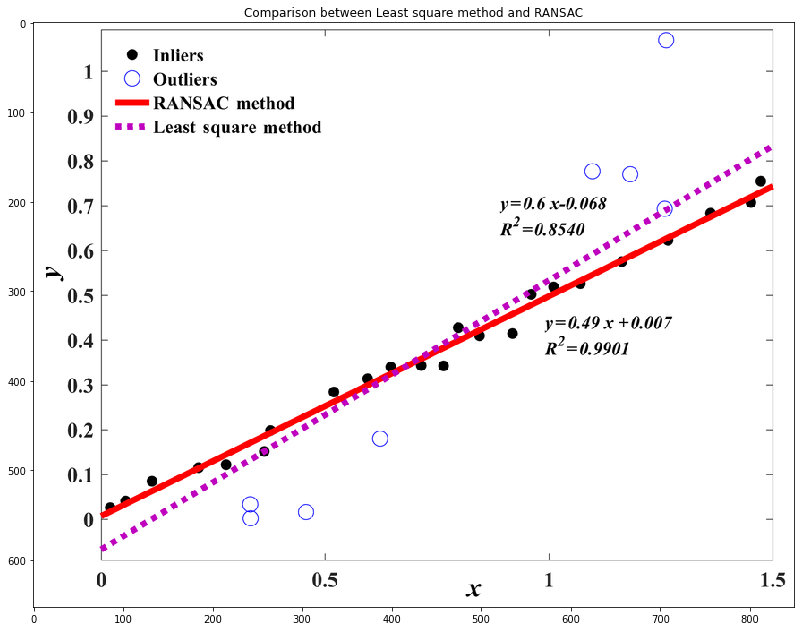

In [10]:
def display_RANSAC(image_group, size, r, c):
    # Show image using pyplot 
    fig = plt.figure(figsize=(size, size))
    rows = r
    columns = c
    num = 1

    while image_group:
      image_node = image_group.pop(0)
      image_content = image_node[0]
      image_caption = image_node[1]
      fig.add_subplot(rows, columns, num)
      plt.imshow(image_content)
      plt.title(image_caption)
      plt.axis('on')
      num+=1

LSM_list = []
LSM = cv.imread("/content/Comparison-of-the-fitted-lines-obtained-from-the-RANSAC-algorithm-and-the-least-squares.ppm")
LSM_list.append([LSM, "Comparison between Least square method and RANSAC"])

display_RANSAC(LSM_list, 30, 1, 2)

In [127]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')



------------------------------------------------------------------------------------------------------



What I observed:

The figures shown above demonstrated the effect of using RANSAC to compute homography. The RANSAC algorithm is a robust data fitting algorithm. Its basic assumption is that a set of data contains a sample data set composed of correct data and a small amount of abnormal data. Iteratively eliminates the process of erroneous data. Applying the RANSAC algorithm to the feature point matching screening can effectively eliminate the error matching points. As we can see from the figures shown above, although the number of inliers is less than the least square method, RANSAC has matched the query book with more accuracy as the red lines have mostly fitted the book cover. RANSAC is an easily implementable method to estimate a model that often works well in practice. However, there are many parameters to tune; it may take a long time to get to the accuracy that you need and requires the inlier to outlier ratio to be reasonable. Often,RANSAC doesn’t work well if the inlier/outlier ratio is
greater than 50%.

In [128]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')



------------------------------------------------------------------------------------------------------



6. Finally, try matching several different image pairs from the data provided, including at least one success and one failure case. For the failure case, test and explain what step in the feature matching has failed, and try to improve it. Display and discuss your findings.
    1. Hint 1: In general, the book covers should be the easiest to match, while the landmarks are the hardest.
    2. Hint 2: Explain why you chose each example shown, and what parameter settings were used.
    3. Hint 3: Possible failure points include the feature detector, the feature descriptor, the matching strategy, or a combination of these.

In [129]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')



------------------------------------------------------------------------------------------------------



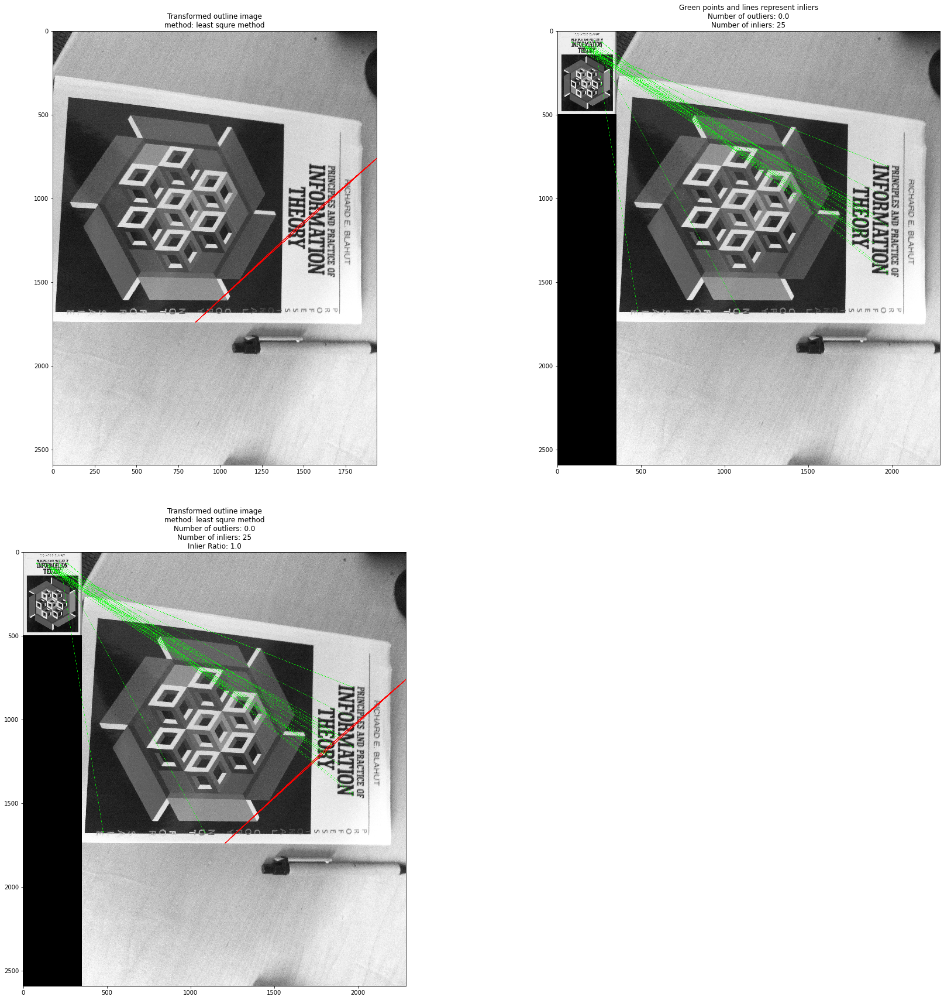

In [26]:
# Your code to display book location here
ref_img = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/book_covers/Reference/066.jpg", 0)
que_img = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/book_covers/Query/066.jpg", 0)

orb = cv.ORB_create()

kp_ref = orb.detect(ref_img, None)
kp_que = orb.detect(que_img, None)

kp_ref, des_ref = orb.compute(ref_img, kp_ref)
kp_que, des_que = orb.compute(que_img, kp_que)


# draw keypoints
ref_img_kp = cv.drawKeypoints(ref_img, kp_ref, None, color=(0,255,0), flags=0)
que_img_kp = cv.drawKeypoints(que_img, kp_que, None, color=(0,255,0), flags=0)


# create BFMatcher object
matcher = cv.BFMatcher(cv.NORM_HAMMING)

# Match descriptors.
matches = matcher.knnMatch(des_ref, des_que, k=2)
# Apply ratio test
good = []
good_without_list = []
for m,n in matches:
  if m.distance < 0.75*n.distance:
    good.append([m])
    good_without_list.append(m)

MIN_MATCH_COUNT = 10
if len(good_without_list)>MIN_MATCH_COUNT:
        src_pts = np.float32([ kp_ref[m.queryIdx].pt for m in good_without_list ]).reshape(-1,1,2)
        dst_pts = np.float32([ kp_que[m.trainIdx].pt for m in good_without_list ]).reshape(-1,1,2)

# using regular method (cv2.findHomography)
M, mask = cv.findHomography(src_pts, dst_pts)
#number of detected outliers: 
num_outliers = len(mask) - np.sum(mask)
#number of detected inliers: 
num_inliers = np.sum(mask)
#Inlier Ratio, number of inlier/number of matches: 
Inlier_Ratio = float(np.sum(mask)) / float(len(mask))

img_matching = []
# draw outline
outline_img = draw_outline(ref_img, que_img, M)

img_matching.append([outline_img, "Transformed outline image", "least squre method"])
# draw inliers

inliers_img = draw_inliers(ref_img, que_img, kp_ref, kp_que, good_without_list, mask)
img_matching.append([inliers_img, "Green points and lines represent inliers", num_outliers, num_inliers])
comb_img = draw_inliers(ref_img, outline_img, kp_ref, kp_que, good_without_list, mask)
img_matching.append([comb_img, "Transformed outline image", "least squre method", num_outliers, num_inliers, Inlier_Ratio])

display_all_2(img_matching, 30, 2, 2)

In [130]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')



------------------------------------------------------------------------------------------------------



What I observed:

The above Figures demonstrated one failure case from image matching.
The maximum number of features to retain has been set to be 500, this is one parameter from cv.ORB_create(). The matching strategy used here is the least square method. As the figures above show, the image matching failed when using ORB to detect image features and using the least square method for image matching. This method has a high sensitivity to outliers and is likely to overfit data. 

In [131]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')



------------------------------------------------------------------------------------------------------



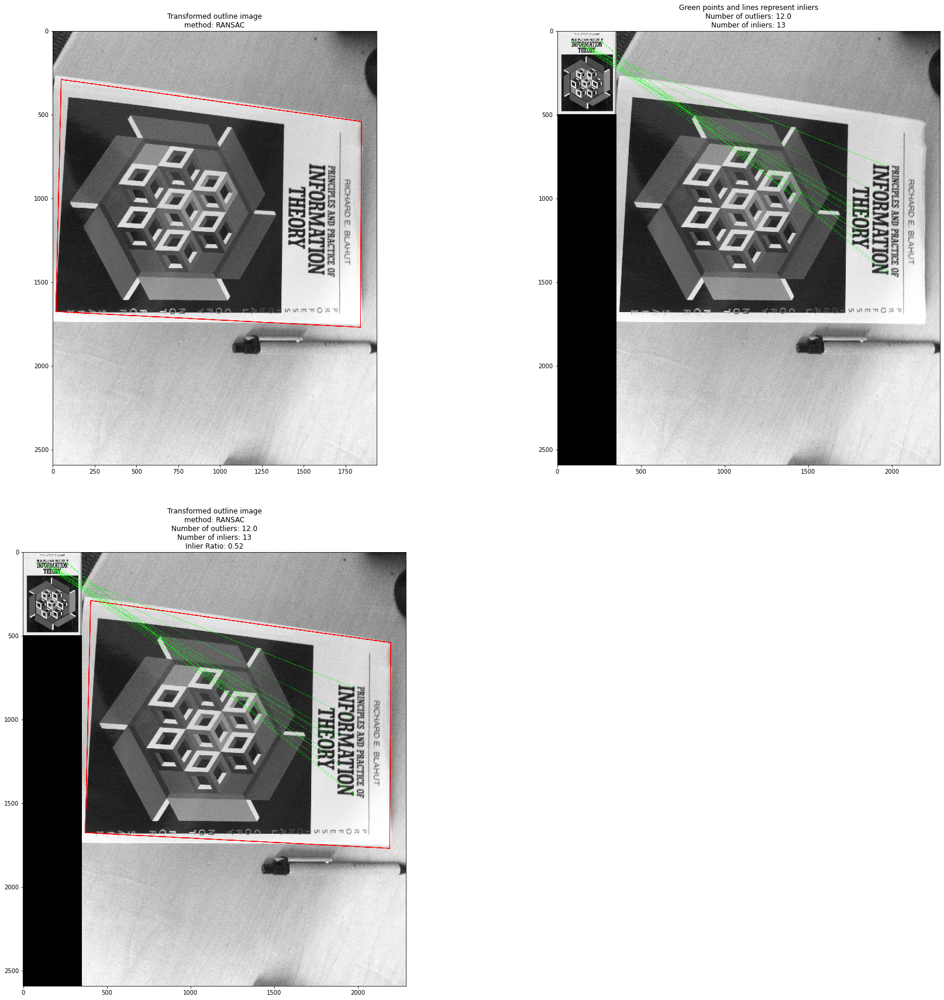

In [25]:
# Your code to display book location here
ref_img = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/book_covers/Reference/066.jpg", 0)
que_img = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/book_covers/Query/066.jpg", 0)

orb = cv.ORB_create()

kp_ref = orb.detect(ref_img, None)
kp_que = orb.detect(que_img, None)

kp_ref, des_ref = orb.compute(ref_img, kp_ref)
kp_que, des_que = orb.compute(que_img, kp_que)


# draw keypoints
ref_img_kp = cv.drawKeypoints(ref_img, kp_ref, None, color=(0,255,0), flags=0)
que_img_kp = cv.drawKeypoints(que_img, kp_que, None, color=(0,255,0), flags=0)


# create BFMatcher object
matcher = cv.BFMatcher(cv.NORM_HAMMING)

# Match descriptors.
matches = matcher.knnMatch(des_ref, des_que, k=2)
# Apply ratio test
good = []
good_without_list = []
for m,n in matches:
  if m.distance < 0.75*n.distance:
    good.append([m])
    good_without_list.append(m)

MIN_MATCH_COUNT = 10
if len(good_without_list)>MIN_MATCH_COUNT:
        src_pts = np.float32([ kp_ref[m.queryIdx].pt for m in good_without_list ]).reshape(-1,1,2)
        dst_pts = np.float32([ kp_que[m.trainIdx].pt for m in good_without_list ]).reshape(-1,1,2)

# using regular method (cv2.findHomography)
M, mask = cv.findHomography(src_pts, dst_pts, cv.RANSAC,5.0)
#number of detected outliers: 
num_outliers = len(mask) - np.sum(mask)
#number of detected inliers: 
num_inliers = np.sum(mask)
#Inlier Ratio, number of inlier/number of matches: 
Inlier_Ratio = float(np.sum(mask)) / float(len(mask))

img_matching = []
# draw outline
outline_img = draw_outline(ref_img, que_img, M)

img_matching.append([outline_img, "Transformed outline image", "RANSAC"])
# draw inliers

inliers_img = draw_inliers(ref_img, que_img, kp_ref, kp_que, good_without_list, mask)
img_matching.append([inliers_img, "Green points and lines represent inliers", num_outliers, num_inliers])
comb_img = draw_inliers(ref_img, outline_img, kp_ref, kp_que, good_without_list, mask)
img_matching.append([comb_img, "Transformed outline image", "RANSAC", num_outliers, num_inliers, Inlier_Ratio])

display_all_2(img_matching, 30, 2, 2)

In [132]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')



------------------------------------------------------------------------------------------------------



What I observed:

The above figures demonstrated a solution to overcome the previous image matching failure. This algorithm used RANSAC instead of the least square method which can estimate the parameters with a high degree of accuracy even when a significant number of outliers are present in the data set. One drawback of using RANSAC is that there is no upper bound on the time it takes to compute these parameters. When the number of iterations computed is limited the solution obtained may not be optimal, and it may not even fit the data in a good way. In this way RANSAC offers a trade-off; by computing a greater number of iterations the probability of a reasonable model being produced is increased.

In [133]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')



------------------------------------------------------------------------------------------------------



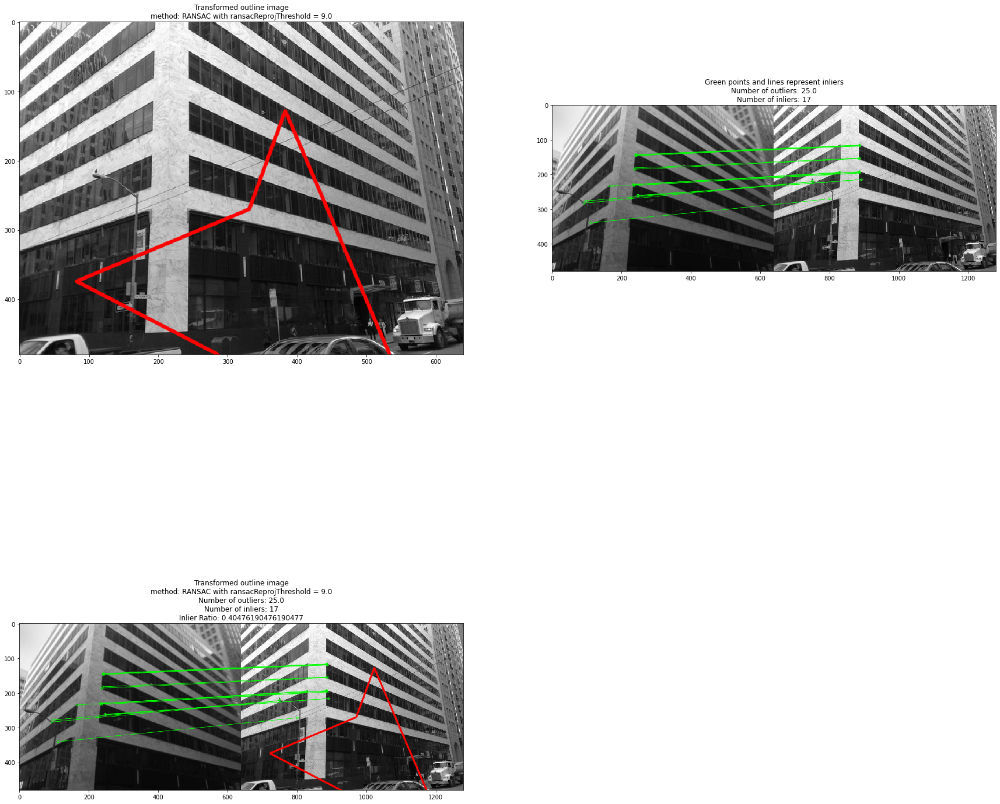

In [19]:
# Your code to display book location here
ref_img = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/landmarks/Reference/019.jpg", 0)
que_img = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/landmarks/Query/019.jpg", 0)

orb = cv.ORB_create()

kp_ref = orb.detect(ref_img, None)
kp_que = orb.detect(que_img, None)

kp_ref, des_ref = orb.compute(ref_img, kp_ref)
kp_que, des_que = orb.compute(que_img, kp_que)


# draw keypoints
ref_img_kp = cv.drawKeypoints(ref_img, kp_ref, None, color=(0,255,0), flags=0)
que_img_kp = cv.drawKeypoints(que_img, kp_que, None, color=(0,255,0), flags=0)


# create BFMatcher object
matcher = cv.BFMatcher(cv.NORM_HAMMING)

# Match descriptors.
matches = matcher.knnMatch(des_ref, des_que, k=2)
# Apply ratio test
good = []
good_without_list = []
for m,n in matches:
  if m.distance < 0.8*n.distance:
    good.append([m])
    good_without_list.append(m)

MIN_MATCH_COUNT = 10
if len(good_without_list)>MIN_MATCH_COUNT:
        src_pts = np.float32([ kp_ref[m.queryIdx].pt for m in good_without_list ]).reshape(-1,1,2)
        dst_pts = np.float32([ kp_que[m.trainIdx].pt for m in good_without_list ]).reshape(-1,1,2)

# using regular method (cv2.findHomography)
M, mask = cv.findHomography(src_pts, dst_pts, cv.RANSAC,9.0)
#number of detected outliers: 
num_outliers = len(mask) - np.sum(mask)
#number of detected inliers: 
num_inliers = np.sum(mask)
#Inlier Ratio, number of inlier/number of matches: 
Inlier_Ratio = float(np.sum(mask)) / float(len(mask))

img_matching = []
# draw outline
outline_img = draw_outline(ref_img, que_img, M)

img_matching.append([outline_img, "Transformed outline image", "RANSAC with ransacReprojThreshold = 9.0"])
# draw inliers

inliers_img = draw_inliers(ref_img, que_img, kp_ref, kp_que, good_without_list, mask)
img_matching.append([inliers_img, "Green points and lines represent inliers", num_outliers, num_inliers])
comb_img = draw_inliers(ref_img, outline_img, kp_ref, kp_que, good_without_list, mask)
img_matching.append([comb_img, "Transformed outline image", "RANSAC with ransacReprojThreshold = 9.0", num_outliers, num_inliers, Inlier_Ratio])

display_all_2(img_matching, 30, 2, 2)

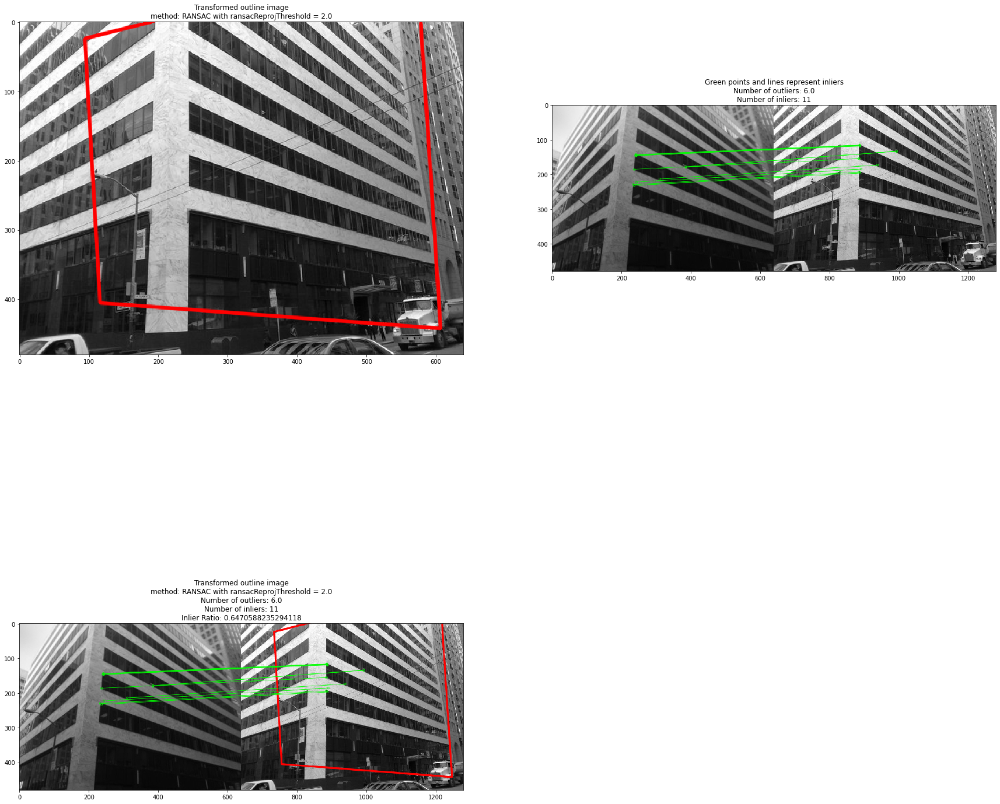

In [24]:
# Your code to display book location here
ref_img = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/landmarks/Reference/019.jpg", 0)
que_img = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/landmarks/Query/019.jpg", 0)

orb = cv.ORB_create(100000000)

kp_ref = orb.detect(ref_img, None)
kp_que = orb.detect(que_img, None)

kp_ref, des_ref = orb.compute(ref_img, kp_ref)
kp_que, des_que = orb.compute(que_img, kp_que)


# draw keypoints
ref_img_kp = cv.drawKeypoints(ref_img, kp_ref, None, color=(0,255,0), flags=0)
que_img_kp = cv.drawKeypoints(que_img, kp_que, None, color=(0,255,0), flags=0)


# create BFMatcher object
matcher = cv.BFMatcher(cv.NORM_HAMMING)

# Match descriptors.
matches = matcher.knnMatch(des_ref, des_que, k=2)
# Apply ratio test
good = []
good_without_list = []
for m,n in matches:
  if m.distance < 0.75*n.distance:
    good.append([m])
    good_without_list.append(m)

MIN_MATCH_COUNT = 10
if len(good_without_list)>MIN_MATCH_COUNT:
        src_pts = np.float32([ kp_ref[m.queryIdx].pt for m in good_without_list ]).reshape(-1,1,2)
        dst_pts = np.float32([ kp_que[m.trainIdx].pt for m in good_without_list ]).reshape(-1,1,2)

# using regular method (cv2.findHomography)
M, mask = cv.findHomography(src_pts, dst_pts, cv.RANSAC,2.0)
#number of detected outliers: 
num_outliers = len(mask) - np.sum(mask)
#number of detected inliers: 
num_inliers = np.sum(mask)
#Inlier Ratio, number of inlier/number of matches: 
Inlier_Ratio = float(np.sum(mask)) / float(len(mask))

img_matching = []
# draw outline
outline_img = draw_outline(ref_img, que_img, M)

img_matching.append([outline_img, "Transformed outline image", "RANSAC with ransacReprojThreshold = 2.0"])
# draw inliers

inliers_img = draw_inliers(ref_img, que_img, kp_ref, kp_que, good_without_list, mask)
img_matching.append([inliers_img, "Green points and lines represent inliers", num_outliers, num_inliers])
comb_img = draw_inliers(ref_img, outline_img, kp_ref, kp_que, good_without_list, mask)
img_matching.append([comb_img, "Transformed outline image", "RANSAC with ransacReprojThreshold = 2.0", num_outliers, num_inliers, Inlier_Ratio])

display_all_2(img_matching, 30, 2, 2)

In [134]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')



------------------------------------------------------------------------------------------------------



What I observed:

 In the above figures, the maximum number of features to be extracted is set to be 500 and 10000 respectively, and clearly, the image with 10000 feature points is more accurate. The features to be extracted can be broadly
classified into two categories, namely, local and global features.
Global features are good, in the context of image retrieval, Object
recognition to describe the information of the image
but they end up mixing the information of foreground and
background. These features are well suited for most of the shape
and texture descriptions, but they are affected by partial occlusion
and clutter. Thus they are not suitable for the localization of objects
spatially. Local features are invariant, they differ from immediate neighbors and allow matching local
structures between the images efficiently. Local features may be
points, edges, lines, segments, or objects that have specific structures
in the image. These features are also referred to as corner
points, key points, or feature points. Therefore, more local features would give us more information about the image, hence, more accurate image matching would be.

# Question 2: What am I looking at? (40%)


<!--One application of feature matching is image retrieval. The goal of image retrieval is, given a query image of an object, to find all images in a database containing the same object, and return the results in ranked order (like a Google search). This is a huge research area but we will implement a very basic version of the problem based on the small dataset provided.-->

In this question, the aim is to identify an "unknown" object depicted in a query image, by matching it to multiple reference images, and selecting the highest scoring match. Since we only have one reference image per object, there is at most one correct answer. This is useful for example if you want to automatically identify a book from a picture of its cover, or a painting or a geographic location from an unlabelled photograph of it.

The steps are as follows:

1. Select a set of reference images and their corresponding query images. 

    1. Hint 1: Start with the book covers, or just a subset of them.
    3. Hing 2: This question can require a lot of computation to run from start to finish, so cache intermediate results (e.g. feature descriptors) where you can.
    
2. Choose one query image corresponding to one of your reference images. Use RANSAC to match your query image to each reference image, and count the number of inlier matches found in each case. This will be the matching score for that image.

3. Identify the query object. This is the identity of the reference image with the highest match score, or "not in dataset" if the maximum score is below a threshold.

4. Repeat steps 2-3 for every query image and report the overall accuracy of your method (that is, the percentage of query images that were correctly matched in the dataset). Discussion of results should include both overall accuracy and individual failure cases.

    1. Hint 1: In case of failure, what ranking did the actual match receive? If we used a "top-k" accuracy measure, where a match is considered correct if it appears in the top k match scores, would that change the result?

<!--Code to implement this algorithm should mostly be written in a supporting file such as a2code.py. Call your code and display outputs in the notebook below.--> 


In [ ]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')



------------------------------------------------------------------------------------------------------



Section 1:

10 query images and their corresponding reference images have been selected from book cover image set.

In [ ]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')
print("results:")



------------------------------------------------------------------------------------------------------

results:


In [51]:
def myFunc(e):
  return e[2]


def img_matching (image_que_list, image_ref_list, hashMap_ref_kp, hashMap_ref_des, sort_inliers, success_cases, failed_cases, less_than_thresh, actual_rank):
  start = True
  orb = cv.ORB_create(10000)
  num_inliers = []
  for que_image in image_que_list:
    if start != True:
      sort_inliers.sort(key=myFunc, reverse=True)
      num_inliers.sort(reverse=True)
      top_node = sort_inliers[0]
      if top_node[0] == top_node[1] and top_node[2] > 10:
        success_cases.append([top_node, num_inliers])
      elif top_node[2] < 10:
        less_than_thresh.append([top_node, num_inliers])
      else:
        failed_cases.append([top_node, num_inliers])
        count = 1
        for node in sort_inliers:
          if node[3] == True:
            actual_rank.append(count)
            break
          count+=1
    curr_que_image = que_image[0]
    curr_que_title = que_image[1]
    kp_que = orb.detect(curr_que_image, None)
    kp_que, des_que = orb.compute(curr_que_image, kp_que)
    result_similarity = 0
    best_matching_score = 0
    sort_inliers = []
    num_inliers = []
    start = False
    for ref_image in image_ref_list:
      curr_ref_image = ref_image[0]
      curr_ref_title = ref_image[1]
      
      if curr_ref_title in hashMap_ref_kp:
        kp_ref = hashMap_ref_kp[curr_ref_title]
        des_ref = hashMap_ref_des[curr_ref_title]
      else:
        kp_ref = orb.detect(curr_ref_image, None)
        kp_ref, des_ref = orb.compute(curr_ref_image, kp_ref)

        hashMap_ref_kp[curr_ref_title] = kp_ref
        hashMap_ref_des[curr_ref_title] = des_ref

      matcher = cv.BFMatcher(cv.NORM_HAMMING)
      matches = matcher.knnMatch(des_ref, des_que, k=2)

      good = []
      good_without_list = []
      for m,n in matches:
        if m.distance < 0.75*n.distance:
          good.append([m])
          good_without_list.append(m)

      MIN_MATCH_COUNT = 4
      if len(good_without_list)> MIN_MATCH_COUNT:
        src_pts = np.float32([ kp_ref[m.queryIdx].pt for m in good_without_list ]).reshape(-1,1,2)
        dst_pts = np.float32([ kp_que[m.trainIdx].pt for m in good_without_list ]).reshape(-1,1,2)

      # using regular method (cv2.findHomography)
        M, mask = cv.findHomography(src_pts, dst_pts, cv.RANSAC,5.0)
        #number of detected inliers: 
        sort_inliers.append([curr_que_title, curr_ref_title, np.sum(mask), curr_que_title==curr_ref_title])
        num_inliers.append(np.sum(mask))

  sort_inliers.sort(key=myFunc, reverse=True)
  num_inliers.sort(reverse=True)
  top_node = sort_inliers[0]
  if top_node[0] == top_node[1] and top_node[2] > 10:
      success_cases.append([top_node, num_inliers])
  elif top_node[2] < 10:
      less_than_thresh.append([top_node, num_inliers])
  else:
    failed_cases.append([top_node, num_inliers])
    count = 1
    for node in sort_inliers:
      if node[3] == True:
        actual_rank.append(count)
        break
      count+=1



In [ ]:
import numpy as np
import glob

def myFunc(e):
  return e[1]

book_que_list = []
book_ref_list = []


for f in glob.iglob("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/book_covers/Query/*.jpg"):
  image = cv.imread(f, cv.IMREAD_GRAYSCALE)
  book_que_list.append([image, f[74:77]])

book_que_list.sort(key=myFunc)
book_que_list = book_que_list[:10]

for f in glob.iglob("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/book_covers/Reference/*.jpg"):
  image = cv.imread(f, cv.IMREAD_GRAYSCALE)
  book_ref_list.append([image, f[78:81]])

book_ref_list.sort(key=myFunc)
book_ref_list = book_ref_list[:10]

In [ ]:
hashMap_ref_kp = {}
hashMap_ref_des = {}
sort_inliers = []
success_cases = []
failed_cases = []
less_than_thresh = []
actual_rank = []


orb = cv.ORB_create(1000)

img_matching(book_que_list, book_ref_list, hashMap_ref_kp, hashMap_ref_des, sort_inliers, success_cases, failed_cases, less_than_thresh, actual_rank)

print("Query images matched to Reference images with highest matching scores and same title:")
print('------------------------------------------------------------------------------------------------------\n')

for node in success_cases:
  print(f'Query image {node[0][0]} matched to reference image {node[0][1]}')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print(f'Highest matching score is: {node[0][2]}')
  print('------------------------------')

print("\n")
print("Query images matched with wrong Reference images: ")
print('------------------------------------------------------------------------------------------------------\n')

ind = 0
index = 0
for node in failed_cases:
  if index == len(actual_rank):
    break
  print(f'Query image {node[0][0]} matched with wrong reference image {node[0][1]}')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print("The actual rank of matching is: " + str(actual_rank[ind]))
  print('------------------------------')
  ind+=1
  index+=1

print("\n")
print("Query images have same title as Reference image but highest matching score is less than a threshold: ")
print('------------------------------------------------------------------------------------------------------\n')

for node in less_than_thresh:
  print(f'Query image {node[0][0]} is not in the dataset')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print(f'The highest matching score {node[0][2]} is less than threshold 15')
  print('------------------------------')

print("\n")
print('------------------------------------------------------------------------------------------------------\n')

Total_cases = len(book_que_list)
success = len(success_cases)
failed = len(failed_cases)
not_dataset = len(less_than_thresh)
print("Total number of image matched is: " + str(Total_cases))
print("Total number of matched image is: " + str(success))
print("Total number of query image macthed wrong with reference is : " + str(failed))
print("Total number of query image not in the dataset is : " + str(not_dataset))
print("Overall accuracy is: " + str((success)/Total_cases))



Query images matched to Reference images with highest matching scores and same title:
------------------------------------------------------------------------------------------------------

Query image 001 matched to reference image 001
Number of inlier matches found in each case: [78, 4]
Highest matching score is: 78
------------------------------
Query image 002 matched to reference image 002
Number of inlier matches found in each case: [55, 6, 5, 4, 4, 4, 0, 0]
Highest matching score is: 55
------------------------------
Query image 003 matched to reference image 003
Number of inlier matches found in each case: [84, 5, 5, 4, 4]
Highest matching score is: 84
------------------------------
Query image 004 matched to reference image 004
Number of inlier matches found in each case: [28, 4, 4, 4, 0, 0]
Highest matching score is: 28
------------------------------
Query image 005 matched to reference image 005
Number of inlier matches found in each case: [47, 4, 4, 4, 0]
Highest matching s

In [ ]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')



------------------------------------------------------------------------------------------------------



Section 2:

10 query images and their corresponding reference images have been selected from landmarks image set.

In [ ]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')
print("results:")



------------------------------------------------------------------------------------------------------

results:


In [ ]:
import numpy as np
import glob

def myFunc(e):
  return e[1]

museum_que_list = []
museum_ref_list = []


for f in glob.iglob("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/landmarks/Query/*.jpg"):
  image = cv.imread(f, cv.IMREAD_GRAYSCALE)
  museum_que_list.append([image, f[72:75]])

museum_que_list.sort(key=myFunc)
museum_que_list = museum_que_list[:10]

for f in glob.iglob("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/landmarks/Reference/*.jpg"):
  image = cv.imread(f, cv.IMREAD_GRAYSCALE)
  museum_ref_list.append([image, f[76:79]])

museum_ref_list.sort(key=myFunc)
museum_ref_list = museum_ref_list[:10]

print(len(museum_ref_list))
for i in museum_ref_list:
  print(i[1])

In [ ]:
hashMap_ref_kp = {}
hashMap_ref_des = {}
sort_inliers = []
success_cases = []
failed_cases = []
less_than_thresh = []
actual_rank = []


orb = cv.ORB_create(1000)

img_matching(museum_que_list, museum_ref_list, hashMap_ref_kp, hashMap_ref_des, sort_inliers, success_cases, failed_cases, less_than_thresh, actual_rank)

print("Query images matched to Reference images with highest matching scores and same title:")
print('------------------------------------------------------------------------------------------------------\n')

for node in success_cases:
  print(f'Query image {node[0][0]} matched to reference image {node[0][1]}')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print(f'Highest matching score is: {node[0][2]}')
  print('------------------------------')

print("\n")
print("Query images matched with wrong Reference images: ")
print('------------------------------------------------------------------------------------------------------\n')

ind = 0
index = 0
for node in failed_cases:
  if index == len(actual_rank):
    break
  print(f'Query image {node[0][0]} matched with wrong reference image {node[0][1]}')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print("The actual rank of matching is: " + str(actual_rank[ind]))
  print('------------------------------')
  ind+=1
  index+=1

print("\n")
print("Query images have same title as Reference image but highest matching score is less than a threshold: ")
print('------------------------------------------------------------------------------------------------------\n')

for node in less_than_thresh:
  print(f'Query image {node[0][0]} is not in the dataset')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print(f'The highest matching score {node[0][2]} is less than threshold 10')
  print('------------------------------')

print("\n")
print('------------------------------------------------------------------------------------------------------\n')

Total_cases = len(book_que_list)
success = len(success_cases)
failed = len(failed_cases)
not_dataset = len(less_than_thresh)
print("Total number of image matched is: " + str(Total_cases))
print("Total number of matched image is: " + str(success))
print("Total number of query image macthed wrong with reference is : " + str(failed))
print("Total number of query image not in the dataset is : " + str(not_dataset))
print("Overall accuracy is: " + str((success)/Total_cases))



Query images matched to Reference images with highest matching scores and same title:
------------------------------------------------------------------------------------------------------

Query image 000 matched to reference image 000
Number of inlier matches found in each case: [17, 8, 6, 5, 5, 5, 4, 4, 4, 4]
Highest matching score is: 17
------------------------------
Query image 001 matched to reference image 001
Number of inlier matches found in each case: [14, 7, 6, 6, 4, 4, 0, 0]
Highest matching score is: 14
------------------------------
Query image 004 matched to reference image 004
Number of inlier matches found in each case: [7, 7, 6, 6, 5, 5, 5, 4, 4, 4]
Highest matching score is: 7
------------------------------
Query image 006 matched to reference image 006
Number of inlier matches found in each case: [19, 6, 5, 4, 4, 4, 4, 4]
Highest matching score is: 19
------------------------------
Query image 007 matched to reference image 007
Number of inlier matches found in eac

In [ ]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')



------------------------------------------------------------------------------------------------------



Section 3:

Top-k accuracy measurement method has been used in order to improve landmamrks image matching accuracy.

In [74]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')
print("results:")



------------------------------------------------------------------------------------------------------

results:


In [ ]:
def myFunc(e):
  return e[2]


def img_matching_topK (image_que_list, image_ref_list, hashMap_ref_kp, hashMap_ref_des, sort_inliers, success_cases, failed_cases, less_than_thresh, actual_rank):
  start = True
  orb = cv.ORB_create(10000)
  num_inliers = []
  for que_image in image_que_list:
    if start != True:
      sort_inliers.sort(key=myFunc, reverse=True)
      num_inliers.sort(reverse=True)
      top_node = sort_inliers[0]
      second_node = sort_inliers[1]
      third_node = sort_inliers[2]
      if (top_node[3] == True and top_node[2] > 4) or (second_node[3] == True and second_node[2] > 4) or (third_node[3] == True and third_node[2] > 4):
        if top_node[3] == True and top_node[2] > 4:
          success_cases.append([top_node, num_inliers])
        elif second_node[3] == True and second_node[2] > 4:
          success_cases.append([second_node, num_inliers])
        elif third_node[3] == True and third_node[2] > 4:
          success_cases.append([third_node, num_inliers])
      elif top_node[3] == True:
          less_than_thresh.append([top_node, num_inliers])
      else:
        failed_cases.append([top_node, num_inliers])
        count = 1
        for node in sort_inliers:
          if node[3] == True:
            actual_rank.append(count)
            break
          count+=1
    curr_que_image = que_image[0]
    curr_que_title = que_image[1]
    kp_que = orb.detect(curr_que_image, None)
    kp_que, des_que = orb.compute(curr_que_image, kp_que)
    result_similarity = 0
    best_matching_score = 0
    sort_inliers = []
    num_inliers = []
    start = False
    for ref_image in image_ref_list:
      curr_ref_image = ref_image[0]
      curr_ref_title = ref_image[1]
      
      if curr_ref_title in hashMap_ref_kp:
        kp_ref = hashMap_ref_kp[curr_ref_title]
        des_ref = hashMap_ref_des[curr_ref_title]
      else:
        kp_ref = orb.detect(curr_ref_image, None)
        kp_ref, des_ref = orb.compute(curr_ref_image, kp_ref)

        hashMap_ref_kp[curr_ref_title] = kp_ref
        hashMap_ref_des[curr_ref_title] = des_ref

      matcher = cv.BFMatcher(cv.NORM_HAMMING)
      matches = matcher.knnMatch(des_ref, des_que, k=2)

      good = []
      good_without_list = []
      for m,n in matches:
        if m.distance < 0.75*n.distance:
          good.append([m])
          good_without_list.append(m)

      MIN_MATCH_COUNT = 4
      if len(good_without_list)> MIN_MATCH_COUNT:
        src_pts = np.float32([ kp_ref[m.queryIdx].pt for m in good_without_list ]).reshape(-1,1,2)
        dst_pts = np.float32([ kp_que[m.trainIdx].pt for m in good_without_list ]).reshape(-1,1,2)

      # using regular method (cv2.findHomography)
        M, mask = cv.findHomography(src_pts, dst_pts, cv.RANSAC,5.0)
        #number of detected inliers: 
        sort_inliers.append([curr_que_title, curr_ref_title, np.sum(mask), curr_que_title==curr_ref_title])
        num_inliers.append(np.sum(mask))

  sort_inliers.sort(key=myFunc, reverse=True)
  num_inliers.sort(reverse=True)
  top_node = sort_inliers[0]
  second_node = sort_inliers[1]
  third_node = sort_inliers[2]
  if (top_node[3] == True and top_node[2] > 4) or (second_node[3] == True and second_node[2] > 4) or (third_node[3] == True and third_node[2] > 4):
    if top_node[3] == True and top_node[2] > 4:
      success_cases.append([top_node, num_inliers])
    elif second_node[3] == True and second_node[2] > 4:
      success_cases.append([second_node, num_inliers])
    elif third_node[3] == True and third_node[2] > 4:
      success_cases.append([third_node, num_inliers])
  elif top_node[3] == True:
          less_than_thresh.append([top_node, num_inliers])
  else:
    failed_cases.append([top_node, num_inliers])
    count = 1
    for node in sort_inliers:
      if node[3] == True:
        actual_rank.append(count)
        break
      count+=1



In [ ]:
hashMap_ref_kp = {}
hashMap_ref_des = {}
sort_inliers = []
success_cases = []
failed_cases = []
less_than_thresh = []
actual_rank = []


orb = cv.ORB_create(1000)

img_matching_topK(museum_que_list, museum_ref_list, hashMap_ref_kp, hashMap_ref_des, sort_inliers, success_cases, failed_cases, less_than_thresh, actual_rank)

print("Query images matched to Reference images by using top 3 method:")
print('------------------------------------------------------------------------------------------------------\n')

for node in success_cases:
  print(f'Query image {node[0][0]} matched to reference image {node[0][1]}')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print(f'Highest matching score is: {node[0][2]}')
  print('------------------------------')

print("\n")
print("Query images matched with wrong Reference images: ")
print('------------------------------------------------------------------------------------------------------\n')

ind = 0
index = 0
for node in failed_cases:
  if index == len(actual_rank):
    break
  print(f'Query image {node[0][0]} matched with wrong reference image {node[0][1]}')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print("The actual rank of matching is: " + str(actual_rank[ind]))
  print('------------------------------')
  ind+=1
  index+=1

print("\n")
print("Query images have same title as Reference image but highest matching score is less than a threshold: ")
print('------------------------------------------------------------------------------------------------------\n')

for node in less_than_thresh:
  print(f'Query image {node[0][0]} is not in the dataset')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print(f'The highest matching score {node[0][2]} is less than threshold 10')
  print('------------------------------')

print("\n")
print('------------------------------------------------------------------------------------------------------\n')

Total_cases = len(book_que_list)
success = len(success_cases)
failed = len(failed_cases)
not_dataset = len(less_than_thresh)
print("Total number of image matched is: " + str(Total_cases))
print("Total number of matched image is: " + str(success))
print("Total number of query image macthed wrong with reference is : " + str(failed))
print("Total number of query image not in the dataset is : " + str(not_dataset))
print("Overall accuracy is: " + str((success)/Total_cases))



Query images matched to Reference images by using top 3 method:
------------------------------------------------------------------------------------------------------

Query image 000 matched to reference image 000
Number of inlier matches found in each case: [17, 8, 6, 5, 5, 5, 4, 4, 4, 4]
Highest matching score is: 17
------------------------------
Query image 001 matched to reference image 001
Number of inlier matches found in each case: [14, 7, 6, 6, 4, 4, 0, 0]
Highest matching score is: 14
------------------------------
Query image 002 matched to reference image 002
Number of inlier matches found in each case: [9, 8, 7, 6, 5, 5, 4, 4]
Highest matching score is: 7
------------------------------
Query image 004 matched to reference image 004
Number of inlier matches found in each case: [7, 7, 6, 6, 5, 5, 5, 4, 4, 4]
Highest matching score is: 7
------------------------------
Query image 005 matched to reference image 005
Number of inlier matches found in each case: [7, 6, 5, 5, 4, 

In [ ]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n') 




------------------------------------------------------------------------------------------------------



The explanation of what I have done:

One application of feature matching is image retrieval. The goal of image retrieval is, given a query image of an object, to find all images in a database containing the same object, and return the results in ranked order. In section 1, 10 query images and their corresponding reference images have been selected from the book cover image set, the algorithm has set the number of feature points extracted to be 500 and the threshold to be 10. The Overall accuracy is 90%, meaning 90% of query images can be successfully retrieved. Similarly, in section 2, 10 query images and their corresponding reference images have been selected from the landmarks image set and the number of feature points was set to be 10000 this time, the threshold was 4. The algorithm report the overall accuracy for the landmarks image set is only 60%. For each failure case presented in the book cover image as well as in the image of the landmark, the actual rank of matching has shown which we can see that in some cases, the correct image matching may sit in the second or third rank. By observing this fact, the TOP K measurement has been used in the algorithm to improve matching accuracy. Top k accuracy is when you measure how often your predicted class(actual matching) falls in the top k values of your softmax distribution. Top-k measurement provides us the ability to find the correct image matching when the actual matching score is not significantly small. Section 3 has clearly demonstrated how the overall accuracy has been improved when the top-k measure has been used. As we can see from the results, the overall accuracy has been improved from 60% to 90%.

In [147]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n') 




------------------------------------------------------------------------------------------------------



In [ ]:
from google.colab import drive
drive.mount('/content/drive')

5. Choose some extra query images of objects that do not occur in the reference dataset. Repeat step 4 with these images added to your query set. Accuracy is now measured by the percentage of query images correctly identified in the dataset, or correctly identified as not occurring in the dataset. Report how accuracy is altered by including these queries, and any changes you have made to improve performance.

In [ ]:
image = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/landmarks/Query/0000.jpg", cv.IMREAD_GRAYSCALE)
book_que_list.append([image, "landmarks_0000"])

image = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/museum_paintings/Query/019.jpg", cv.IMREAD_GRAYSCALE)
book_que_list.append([image, "museum_paintings_019"])



In [73]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')




------------------------------------------------------------------------------------------------------



Section 2.1:

10 query images and their corresponding reference images have been selected from book cover image set, moreover, 2 extra images from landmarks and museum_paintings have been selected and added to the book cover query set.  


In [75]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')
print("results:")



------------------------------------------------------------------------------------------------------

results:


In [ ]:
hashMap_ref_kp = {}
hashMap_ref_des = {}
sort_inliers = []
success_cases = []
failed_cases = []
less_than_thresh = []
actual_rank = []


orb = cv.ORB_create(1000)

img_matching(book_que_list, book_ref_list, hashMap_ref_kp, hashMap_ref_des, sort_inliers, success_cases, failed_cases, less_than_thresh, actual_rank)

print("Query images matched to Reference images by using top 3 method:")
print('------------------------------------------------------------------------------------------------------\n')

for node in success_cases:
  print(f'Query image {node[0][0]} matched to reference image {node[0][1]}')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print(f'Highest matching score is: {node[0][2]}')
  print('------------------------------')

print("\n")
print("Query images matched with wrong Reference images: ")
print('------------------------------------------------------------------------------------------------------\n')

ind = 0
index = 0
for node in failed_cases:
  print(f'Query image {node[0][0]} matched with wrong reference image {node[0][1]}')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print('------------------------------')
  ind+=1
  index+=1

print("\n")
print("Query images have same title as Reference image but highest matching score is less than a threshold: ")
print('------------------------------------------------------------------------------------------------------\n')

for node in less_than_thresh:
  print(f'Query image {node[0][0]} is not in the dataset')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print(f'The highest matching score {node[0][2]} is less than threshold 10')
  print('------------------------------')

print("\n")
print('------------------------------------------------------------------------------------------------------\n')

Total_cases = len(book_que_list)
success = len(success_cases)
failed = len(failed_cases)
not_dataset = len(less_than_thresh)
print("Total number of image matched is: " + str(Total_cases))
print("Total number of matched image is: " + str(success))
print("Total number of query image macthed wrong with reference image is : " + str(failed))
print("Total number of query image not in the dataset is : " + str(not_dataset))
print("Overall accuracy is: " + str((success + not_dataset)/Total_cases))



Query images matched to Reference images by using top 3 method:
------------------------------------------------------------------------------------------------------

Query image 001 matched to reference image 001
Number of inlier matches found in each case: [306, 9, 8, 7, 6, 6, 6, 5, 5, 5]
Highest matching score is: 306
------------------------------
Query image 002 matched to reference image 002
Number of inlier matches found in each case: [191, 8, 8, 7, 6, 6, 6, 5, 4, 4]
Highest matching score is: 191
------------------------------
Query image 003 matched to reference image 003
Number of inlier matches found in each case: [359, 6, 6, 6, 5, 5, 5, 5, 4, 4]
Highest matching score is: 359
------------------------------
Query image 004 matched to reference image 004
Number of inlier matches found in each case: [105, 14, 8, 6, 6, 6, 6, 6, 5, 4]
Highest matching score is: 105
------------------------------
Query image 005 matched to reference image 005
Number of inlier matches found in ea

In [76]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')




------------------------------------------------------------------------------------------------------



Section 2.1:

10 query images and their corresponding reference images have been selected from landmarks image set, and 2 extra images from bookcover and museum_paintings have been selected and added to the landmarks query set.


In [77]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')
print("results:")



------------------------------------------------------------------------------------------------------

results:


In [5]:
image = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/book_covers/Query/001.jpg", cv.IMREAD_GRAYSCALE)
museum_que_list.append([image, "book_covers_001"])

image = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/museum_paintings/Query/019.jpg", cv.IMREAD_GRAYSCALE)
museum_que_list.append([image, "museum_paintings_019"])



In [71]:
hashMap_ref_kp = {}
hashMap_ref_des = {}
sort_inliers = []
success_cases = []
failed_cases = []
less_than_thresh = []
actual_rank = []


orb = cv.ORB_create(1000)

img_matching(museum_que_list, museum_ref_list, hashMap_ref_kp, hashMap_ref_des, sort_inliers, success_cases, failed_cases, less_than_thresh, actual_rank)

print("Query images matched to Reference images with highest matching scores and same title:")
print('------------------------------------------------------------------------------------------------------\n')

for node in success_cases:
  print(f'Query image {node[0][0]} matched to reference image {node[0][1]}')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print(f'Highest matching score is: {node[0][2]}')
  print('------------------------------')

print("\n")
print("Query images matched with wrong Reference images: ")
print('------------------------------------------------------------------------------------------------------\n')

ind = 0
index = 0
for node in failed_cases:
  if index == len(actual_rank):
    break
  print(f'Query image {node[0][0]} matched with wrong reference image {node[0][1]}')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print("The actual rank of matching is: " + str(actual_rank[ind]))
  print('------------------------------')
  ind+=1
  index+=1

print("\n")
print("Query images have same title as Reference image but highest matching score is less than a threshold: ")
print('------------------------------------------------------------------------------------------------------\n')

for node in less_than_thresh:
  print(f'Query image {node[0][0]} is not in the dataset')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print(f'The highest matching score {node[0][2]} is less than threshold 10')
  print('------------------------------')

print("\n")
print('------------------------------------------------------------------------------------------------------\n')

Total_cases = len(museum_que_list)
success = len(success_cases)
failed = len(failed_cases)
not_dataset = len(less_than_thresh)
print("Total number of image matched is: " + str(Total_cases))
print("Total number of matched image is: " + str(success))
print("Total number of query image macthed wrong with reference image is : " + str(failed))
print("Total number of query image not in the dataset is : " + str(not_dataset))
print("Overall accuracy is: " + str((success + 2)/Total_cases))



Query images matched to Reference images with highest matching scores and same title:
------------------------------------------------------------------------------------------------------

Query image 000 matched to reference image 000
Number of inlier matches found in each case: [20, 8, 7, 6, 5, 5, 4, 4, 4, 4]
Highest matching score is: 20
------------------------------
Query image 001 matched to reference image 001
Number of inlier matches found in each case: [15, 7, 6, 5, 5, 4, 4]
Highest matching score is: 15
------------------------------
Query image 006 matched to reference image 006
Number of inlier matches found in each case: [19, 6, 5, 5, 4, 4, 4, 4, 0]
Highest matching score is: 19
------------------------------
Query image 008 matched to reference image 008
Number of inlier matches found in each case: [18, 6, 5, 5, 5, 4]
Highest matching score is: 18
------------------------------


Query images matched with wrong Reference images: 
-----------------------------------------

In [ ]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n') 




------------------------------------------------------------------------------------------------------



Section 2.2:

More feature points have been extracted and SIFT algorithm has been used to improve the algorithm performance.

In [78]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n') 
print("results:")



------------------------------------------------------------------------------------------------------

results:


In [86]:
def myFunc(e):
  return e[2]


def img_matching_SIFT (image_que_list, image_ref_list, hashMap_ref_kp, hashMap_ref_des, sort_inliers, success_cases, failed_cases, less_than_thresh, actual_rank):
  start = True
  sift = cv.SIFT_create(10000)
  num_inliers = []
  for que_image in image_que_list:
    if start != True:
      sort_inliers.sort(key=myFunc, reverse=True)
      num_inliers.sort(reverse=True)
      top_node = sort_inliers[0]
      if top_node[0] == top_node[1] and top_node[2] > 4:
        success_cases.append([top_node, num_inliers])
      elif top_node[2] < 10:
        less_than_thresh.append([top_node, num_inliers])
      else:
        failed_cases.append([top_node, num_inliers])
        count = 1
        for node in sort_inliers:
          if node[3] == True:
            actual_rank.append(count)
            break
          count+=1
    curr_que_image = que_image[0]
    curr_que_title = que_image[1]
    kp_que, des_que = sift.detectAndCompute(curr_que_image, None)
    sort_inliers = []
    num_inliers = []
    start = False
    for ref_image in image_ref_list:
      curr_ref_image = ref_image[0]
      curr_ref_title = ref_image[1]
      
      if curr_ref_title in hashMap_ref_kp:
        kp_ref = hashMap_ref_kp[curr_ref_title]
        des_ref = hashMap_ref_des[curr_ref_title]
      else:
        kp_ref, des_ref = sift.detectAndCompute(curr_ref_image, None)

        hashMap_ref_kp[curr_ref_title] = kp_ref
        hashMap_ref_des[curr_ref_title] = des_ref

      FLANN_INDEX_KDTREE = 1
      index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
      search_params = dict(checks = 50)
      flann = cv.FlannBasedMatcher(index_params, search_params)
      matches = flann.knnMatch(des_ref,des_que,k=2)

      good = []
      good_without_list = []
      for m,n in matches:
        if m.distance < 0.8*n.distance:
          good.append([m])
          good_without_list.append(m)

      MIN_MATCH_COUNT = 4
      if len(good_without_list)> MIN_MATCH_COUNT:
        src_pts = np.float32([ kp_ref[m.queryIdx].pt for m in good_without_list ]).reshape(-1,1,2)
        dst_pts = np.float32([ kp_que[m.trainIdx].pt for m in good_without_list ]).reshape(-1,1,2)

      # using regular method (cv2.findHomography)
        M, mask = cv.findHomography(src_pts, dst_pts, cv.RANSAC,5.0)
        #number of detected inliers: 
        sort_inliers.append([curr_que_title, curr_ref_title, np.sum(mask), curr_que_title==curr_ref_title])
        num_inliers.append(np.sum(mask))

  sort_inliers.sort(key=myFunc, reverse=True)
  num_inliers.sort(reverse=True)
  top_node = sort_inliers[0]
  if top_node[0] == top_node[1] and top_node[2] > 4:
      success_cases.append([top_node, num_inliers])
  elif top_node[2] < 10:
      less_than_thresh.append([top_node, num_inliers])
  else:
    failed_cases.append([top_node, num_inliers])
    count = 1
    for node in sort_inliers:
      if node[3] == True:
        actual_rank.append(count)
        break
      count+=1



In [ ]:
!pip install "opencv-contrib-python>=4.5.1"

In [89]:
hashMap_ref_kp = {}
hashMap_ref_des = {}
sort_inliers = []
success_cases = []
failed_cases = []
less_than_thresh = []
actual_rank = []



img_matching_SIFT(museum_que_list, museum_ref_list, hashMap_ref_kp, hashMap_ref_des, sort_inliers, success_cases, failed_cases, less_than_thresh, actual_rank)

print("Query images matched to Reference images with highest matching scores and same title:")
print('------------------------------------------------------------------------------------------------------\n')

for node in success_cases:
  print(f'Query image {node[0][0]} matched to reference image {node[0][1]}')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print(f'Highest matching score is: {node[0][2]}')
  print('------------------------------')

print("\n")
print("Query images matched with wrong Reference images: ")
print('------------------------------------------------------------------------------------------------------\n')

ind = 0
index = 0
for node in failed_cases:
  print(f'Query image {node[0][0]} matched with wrong reference image {node[0][1]}')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print('------------------------------')
  ind+=1
  index+=1

print("\n")
print("Query images have same title as Reference image but highest matching score is less than a threshold: ")
print('------------------------------------------------------------------------------------------------------\n')

for node in less_than_thresh:
  print(f'Query image {node[0][0]} is not in the dataset')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print(f'The highest matching score {node[0][2]} is less than threshold 10')
  print('------------------------------')

print("\n")
print('------------------------------------------------------------------------------------------------------\n')

Total_cases = len(museum_que_list)
success = len(success_cases)
failed = len(failed_cases)
not_dataset = len(less_than_thresh)
print("Total number of image matched is: " + str(Total_cases))
print("Total number of matched image is: " + str(success))
print("Total number of query image macthed wrong with reference image is : " + str(failed))
print("Total number of query image not in the dataset is : " + str(not_dataset))
print("Overall accuracy is: " + str((success)/Total_cases))



Query images matched to Reference images with highest matching scores and same title:
------------------------------------------------------------------------------------------------------

Query image 000 matched to reference image 000
Number of inlier matches found in each case: [15, 11, 9, 9, 9, 8, 7, 7, 6, 6]
Highest matching score is: 15
------------------------------
Query image 001 matched to reference image 001
Number of inlier matches found in each case: [9, 9, 9, 8, 7, 7, 6, 5, 5, 4]
Highest matching score is: 9
------------------------------
Query image 005 matched to reference image 005
Number of inlier matches found in each case: [10, 9, 8, 8, 7, 6, 6, 6, 5, 5]
Highest matching score is: 10
------------------------------
Query image 006 matched to reference image 006
Number of inlier matches found in each case: [11, 8, 7, 7, 6, 6, 6, 6, 6, 5]
Highest matching score is: 11
------------------------------
Query image 007 matched to reference image 007
Number of inlier matches

In [72]:
print("\n")


The explanation of results and what changes made here:

In section 2.1, 10 query images and their corresponding reference images have been selected from the book cover image set, moreover, 2 extra images from landmarks and museum_paintings have been selected and added to the book cover query set. The overall accuracy of the algorithm is 100%, meaning all the query images have been successfully retrieved and all the extra images have been detected as not in the dataset. In section 2.2, 10 query images and their corresponding reference images have been selected from the landmarks image set, and 2 extra images from the book cover have been selected and added to the landmark query set. The algorithm reported that only 50% of images have been successfully retrieved or correctly identified as not in the dataset. By analyzing sections 2,1 and 2.2, the failure cases could have arisen from the insufficient number of key points and the amount of noise present in the image. Therefore, section 3 has demonstrated how the increase of feature points and using SIFT algorithm affect the performance. SIFT helps locate the local features in an image. These key points are scale & rotation invariant. Although SIFT has proven to be very efficient in object recognition applications, it requires a large computational complexity which is a major drawback, especially for real-time applications. Therefore, we have cached intermediate results for reference images. When we first compare the query image to each reference image, the information of the reference image's key points and descriptors has been stored on a map. In this way, when we compare the second query image to all the reference images, we can directly access the reference image's key points and descriptors without needing to compute them again. Through the results above we can see that since the ORB algorithm is more noise sensitive to SIFT algorithm, more images have been successfully retrieved, meaning a small part of failure cases due to a lot of noise present in the image have been fixed.


6. Repeat step 4 and 5 for at least one other set of reference images from museum_paintings or landmarks, and compare the accuracy obtained. Analyse both your overall result and individual image matches to diagnose where problems are occurring, and what you could do to improve performance. Test at least one of your proposed improvements and report its effect on accuracy.


In [151]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')



------------------------------------------------------------------------------------------------------



Section 3.1:
One additional landmarks reference image and on additional museum_paintings reference image has been added to the reference image data set.

In [152]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')
print("results:")



------------------------------------------------------------------------------------------------------

results:


In [90]:
image = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/landmarks/Reference/027.jpg", cv.IMREAD_GRAYSCALE)
museum_que_list.append([image, "landmarks_027"])

image = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/museum_paintings/Reference/024.jpg", cv.IMREAD_GRAYSCALE)
museum_que_list.append([image, "museum_paintings_024"])

In [ ]:
def myFunc(e):
  return e[2]


def img_matching_BEBLID (image_que_list, image_ref_list, hashMap_ref_kp, hashMap_ref_des, sort_inliers, success_cases, failed_cases, less_than_thresh, actual_rank):
  start = True
  orb = cv.ORB_create(1000000)
  num_inliers = []
  for que_image in image_que_list:
    if start != True:
      sort_inliers.sort(key=myFunc, reverse=True)
      num_inliers.sort(reverse=True)
      top_node = sort_inliers[0]
      if top_node[0] == top_node[1] and top_node[2] > 4:
        success_cases.append([top_node, num_inliers])
      elif top_node[2] < 10:
        less_than_thresh.append([top_node, num_inliers])
      else:
        failed_cases.append([top_node, num_inliers])
        count = 1
        for node in sort_inliers:
          if node[3] == True:
            actual_rank.append(count)
            break
          count+=1
    curr_que_image = que_image[0]
    curr_que_title = que_image[1]
    kp_que = orb.detect(curr_que_image, None)
    descriptor = cv.xfeatures2d.BEBLID_create(0.75)
    kp_que, des_que = descriptor.compute(curr_que_image, kp_que)
    sort_inliers = []
    num_inliers = []
    start = False
    for ref_image in image_ref_list:
      curr_ref_image = ref_image[0]
      curr_ref_title = ref_image[1]
      
      if curr_ref_title in hashMap_ref_kp:
        kp_ref = hashMap_ref_kp[curr_ref_title]
        des_ref = hashMap_ref_des[curr_ref_title]
      else:
        kp_ref = orb.detect(curr_ref_image, None)
        kp_ref, des_ref = descriptor.compute(curr_ref_image, kp_ref)

        hashMap_ref_kp[curr_ref_title] = kp_ref
        hashMap_ref_des[curr_ref_title] = des_ref

      matcher = cv.DescriptorMatcher_create(cv.DescriptorMatcher_BRUTEFORCE_HAMMING)
      matches = matcher.knnMatch(des_ref, des_que, k=2)

      good = []
      good_without_list = []
      for m,n in matches:
        if m.distance < 0.8*n.distance:
          good.append([m])
          good_without_list.append(m)

      MIN_MATCH_COUNT = 4
      if len(good_without_list)> MIN_MATCH_COUNT:
        src_pts = np.float32([ kp_ref[m.queryIdx].pt for m in good_without_list ]).reshape(-1,1,2)
        dst_pts = np.float32([ kp_que[m.trainIdx].pt for m in good_without_list ]).reshape(-1,1,2)

      # using regular method (cv2.findHomography)
        M, mask = cv.findHomography(src_pts, dst_pts, cv.RANSAC,5.0)
        #number of detected inliers: 
        sort_inliers.append([curr_que_title, curr_ref_title, np.sum(mask), curr_que_title==curr_ref_title])
        num_inliers.append(np.sum(mask))

  sort_inliers.sort(key=myFunc, reverse=True)
  num_inliers.sort(reverse=True)
  top_node = sort_inliers[0]
  if top_node[0] == top_node[1] and top_node[2] > 4:
      success_cases.append([top_node, num_inliers])
  elif top_node[2] < 10:
      less_than_thresh.append([top_node, num_inliers])
  else:
    failed_cases.append([top_node, num_inliers])
    count = 1
    for node in sort_inliers:
      if node[3] == True:
        actual_rank.append(count)
        break
      count+=1



In [94]:
hashMap_ref_kp = {}
hashMap_ref_des = {}
sort_inliers = []
success_cases = []
failed_cases = []
less_than_thresh = []
actual_rank = []



img_matching(museum_que_list, museum_ref_list, hashMap_ref_kp, hashMap_ref_des, sort_inliers, success_cases, failed_cases, less_than_thresh, actual_rank)

print("Query images matched to Reference images with highest matching scores and same title:")
print('------------------------------------------------------------------------------------------------------\n')

for node in success_cases:
  print(f'Query image {node[0][0]} matched to reference image {node[0][1]}')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print(f'Highest matching score is: {node[0][2]}')
  print('------------------------------')

print("\n")
print("Query images matched with wrong Reference images: ")
print('------------------------------------------------------------------------------------------------------\n')

ind = 0
index = 0
for node in failed_cases:
  print(f'Query image {node[0][0]} matched with wrong reference image {node[0][1]}')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print('------------------------------')
  ind+=1
  index+=1

print("\n")
print("Query images have same title as Reference image but highest matching score is less than a threshold: ")
print('------------------------------------------------------------------------------------------------------\n')

for node in less_than_thresh:
  print(f'Query image {node[0][0]} is not in the dataset')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print(f'The highest matching score {node[0][2]} is less than threshold 10')
  print('------------------------------')

print("\n")
print('------------------------------------------------------------------------------------------------------\n')

Total_cases = len(museum_que_list)
success = len(success_cases)
failed = len(failed_cases)
not_dataset = len(less_than_thresh)
print("Total number of image matched is: " + str(Total_cases))
print("Total number of matched image is: " + str(success))
print("Total number of query image macthed wrong with reference image is : " + str(failed))
print("Total number of query image not in the dataset is : " + str(not_dataset))
print("Overall accuracy is: " + str((success+3)/Total_cases))



Query images matched to Reference images with highest matching scores and same title:
------------------------------------------------------------------------------------------------------

Query image 000 matched to reference image 000
Number of inlier matches found in each case: [20, 8, 7, 6, 5, 5, 4, 4, 4, 4]
Highest matching score is: 20
------------------------------
Query image 001 matched to reference image 001
Number of inlier matches found in each case: [15, 7, 6, 5, 5, 4, 4]
Highest matching score is: 15
------------------------------
Query image 006 matched to reference image 006
Number of inlier matches found in each case: [19, 6, 5, 5, 4, 4, 4, 4, 0]
Highest matching score is: 19
------------------------------
Query image 008 matched to reference image 008
Number of inlier matches found in each case: [18, 6, 5, 5, 5, 4]
Highest matching score is: 18
------------------------------


Query images matched with wrong Reference images: 
-----------------------------------------

In [153]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')



------------------------------------------------------------------------------------------------------



The output of one faliur case that affected accuracy by using alogorithm above:

In [29]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')



------------------------------------------------------------------------------------------------------



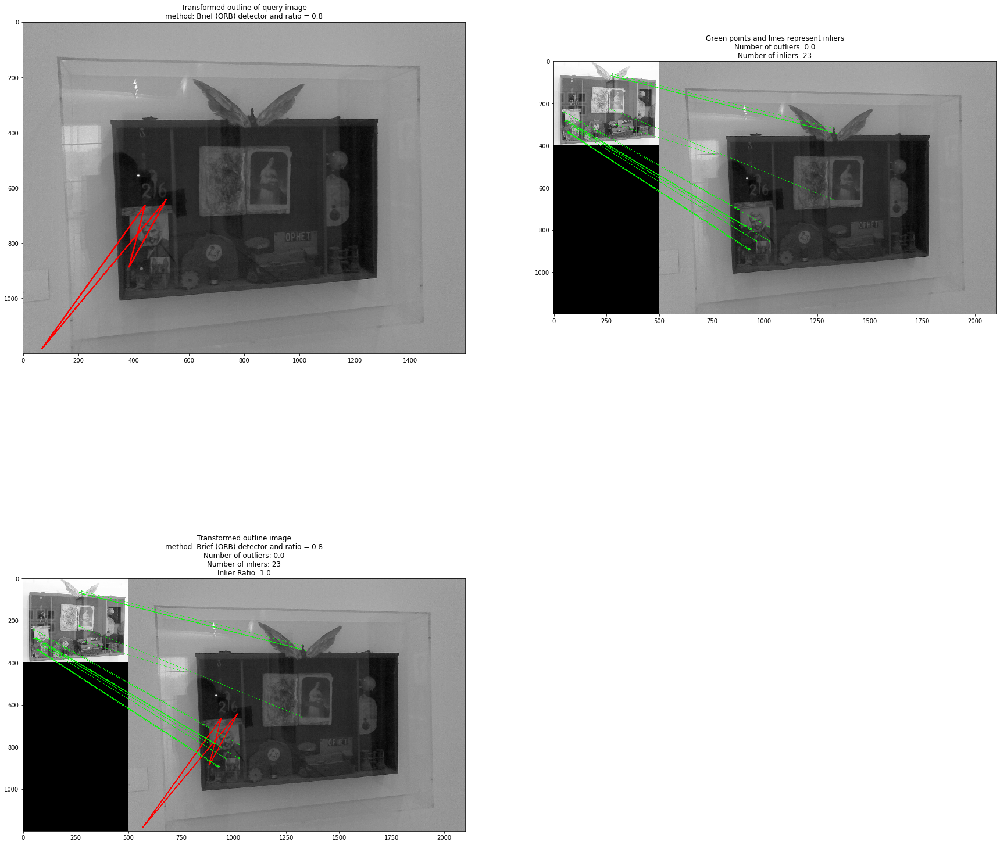

In [40]:
ref_img = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/museum_paintings/Reference/024.jpg", 0)
que_img = cv.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/museum_paintings/Query/024.jpg", 0)

orb = cv.ORB_create()

kp_ref = orb.detect(ref_img, None)
kp_que = orb.detect(que_img, None)

kp_ref, des_ref = orb.compute(ref_img, kp_ref)
kp_que, des_que = orb.compute(que_img, kp_que)


# draw keypoints
ref_img_kp = cv.drawKeypoints(ref_img, kp_ref, None, color=(0,255,0), flags=0)
que_img_kp = cv.drawKeypoints(que_img, kp_que, None, color=(0,255,0), flags=0)


# create BFMatcher object
matcher = cv.BFMatcher(cv.NORM_HAMMING)

# Match descriptors.
matches = matcher.knnMatch(des_ref, des_que, k=2)
# Apply ratio test
good = []
good_without_list = []
for m,n in matches:
  if m.distance < 0.8*n.distance:
    good.append([m])
    good_without_list.append(m)

MIN_MATCH_COUNT = 10
if len(good_without_list)>MIN_MATCH_COUNT:
        src_pts = np.float32([ kp_ref[m.queryIdx].pt for m in good_without_list ]).reshape(-1,1,2)
        dst_pts = np.float32([ kp_que[m.trainIdx].pt for m in good_without_list ]).reshape(-1,1,2)

# using regular method (cv2.findHomography)
M, mask = cv.findHomography(src_pts, dst_pts,0)
#number of detected outliers: 
num_outliers = len(mask) - np.sum(mask)
#number of detected inliers: 
num_inliers = np.sum(mask)
#Inlier Ratio, number of inlier/number of matches: 
Inlier_Ratio = float(np.sum(mask)) / float(len(mask))

img_matching = []
# draw outline
outline_img = draw_outline(ref_img, que_img, M)

img_matching.append([outline_img, "Transformed outline of query image", "Brief (ORB) detector and ratio = 0.8"])
# draw inliers

inliers_img = draw_inliers(ref_img, que_img, kp_ref, kp_que, good_without_list, mask)
img_matching.append([inliers_img, "Green points and lines represent inliers", num_outliers, num_inliers])
comb_img = draw_inliers(ref_img, outline_img, kp_ref, kp_que, good_without_list, mask)
img_matching.append([comb_img, "Transformed outline image", "Brief (ORB) detector and ratio = 0.8", num_outliers, num_inliers, Inlier_Ratio])

display_all_2(img_matching, 30, 2, 2)

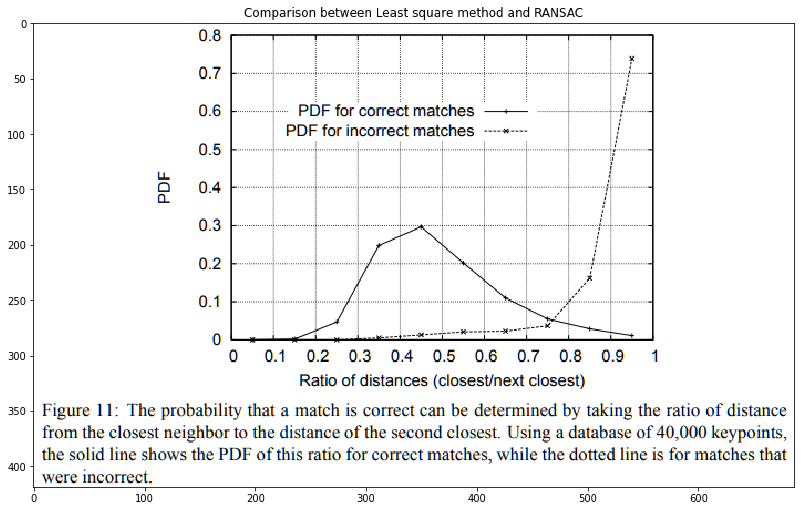

In [42]:
def display_Ratio_test_diff(image_group, size, r, c):
    # Show image using pyplot 
    fig = plt.figure(figsize=(size, size))
    rows = r
    columns = c
    num = 1

    while image_group:
      image_node = image_group.pop(0)
      image_content = image_node[0]
      image_caption = image_node[1]
      fig.add_subplot(rows, columns, num)
      plt.imshow(image_content)
      plt.title(image_caption)
      plt.axis('on')
      num+=1

LSM_list = []
LSM = cv.imread("/content/Feature_FlannMatcher_Lowe_ratio_test.png")
LSM_list.append([LSM, "Comparison between Least square method and RANSAC"])

display_Ratio_test_diff(LSM_list, 30, 1, 2)

In [41]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')



------------------------------------------------------------------------------------------------------



Discussion of the reason for failure:

By observing the above failure case, some nosiy and distinctive distortion are presented in the image. Therefore, in this case, using brief descriptor from ORB and ratio test has failed, due to the insufficient number of feature points detected and selected,and the excessive wrong matches disturbing the iterative parameter estimation process for the RANSAC algorithm. Lowe's ratio test works in this way: each keypoint of the first image is matched with a number of keypoints from the second image. We keep the 2 best matches for each keypoint (best matches = the ones with the smallest distance measurement). Lowe's test checks that the two distances are sufficiently different. If they are not, then the keypoint is eliminated and will not be used for further calculations. In the fowlloing section, an improvement has been proposed by setting different ratio for key points distance check and BELID descriptor and BoostedSSC algorithm have been used to solve the issue present above.

In [43]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')



------------------------------------------------------------------------------------------------------



BELID descriptor and BoostedSSC algorithm have been used to improve performance.

In [154]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')
print("results:")



------------------------------------------------------------------------------------------------------

results:


In [105]:
hashMap_ref_kp = {}
hashMap_ref_des = {}
sort_inliers = []
success_cases = []
failed_cases = []
less_than_thresh = []
actual_rank = []



img_matching_BEBLID(museum_que_list, museum_ref_list, hashMap_ref_kp, hashMap_ref_des, sort_inliers, success_cases, failed_cases, less_than_thresh, actual_rank)

print("Query images matched to Reference images with highest matching scores and same title:")
print('------------------------------------------------------------------------------------------------------\n')

for node in success_cases:
  print(f'Query image {node[0][0]} matched to reference image {node[0][1]}')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print(f'Highest matching score is: {node[0][2]}')
  print('------------------------------')

print("\n")
print("Query images matched with wrong Reference images: ")
print('------------------------------------------------------------------------------------------------------\n')

ind = 0
index = 0
for node in failed_cases:
  print(f'Query image {node[0][0]} matched with wrong reference image {node[0][1]}')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print('------------------------------')
  ind+=1
  index+=1

print("\n")
print("Query images have same title as Reference image but highest matching score is less than a threshold: ")
print('------------------------------------------------------------------------------------------------------\n')

for node in less_than_thresh:
  print(f'Query image {node[0][0]} is not in the dataset')
  print(f'Number of inlier matches found in each case: {node[1]}')
  print(f'The highest matching score {node[0][2]} is less than threshold 10')
  print('------------------------------')

print("\n")
print('------------------------------------------------------------------------------------------------------\n')

Total_cases = len(museum_que_list)
success = len(success_cases)
failed = len(failed_cases)
not_dataset = len(less_than_thresh)
print("Total number of image matched is: " + str(Total_cases))
print("Total number of matched image is: " + str(success))
print("Total number of query image macthed wrong with reference image is : " + str(failed))
print("Total number of query image not in the dataset is : " + str(not_dataset))
print("Overall accuracy is: " + str((success+4)/Total_cases))



Query images matched to Reference images with highest matching scores and same title:
------------------------------------------------------------------------------------------------------

Query image 000 matched to reference image 000
Number of inlier matches found in each case: [15, 5, 5, 4, 4]
Highest matching score is: 15
------------------------------
Query image 001 matched to reference image 001
Number of inlier matches found in each case: [10, 6, 5, 4, 4]
Highest matching score is: 10
------------------------------
Query image 004 matched to reference image 004
Number of inlier matches found in each case: [8, 4, 4, 4, 4, 0]
Highest matching score is: 8
------------------------------
Query image 006 matched to reference image 006
Number of inlier matches found in each case: [20, 5, 5, 4, 4]
Highest matching score is: 20
------------------------------
Query image 007 matched to reference image 007
Number of inlier matches found in each case: [9, 6, 5, 4, 4, 0, 0]
Highest matchin

In [155]:
print("\n")
print('------------------------------------------------------------------------------------------------------\n')



------------------------------------------------------------------------------------------------------



***Your description of what you have done, and explanation of results, here***

Local image representations are designed to match images
in the presence of strong appearance variations, such as illumination changes or geometric transformations. In this section, we have introduced BELID, an efficient real-valued descriptor.  In BELID we use the BoostedSSC algorithm to discriminatively select a set of features and combine them to
produce a strong description. BELID achieves execution times
close to the fastest technique, ORB  with an accuracy similar to that of SIFT. Specifically, it
provides accuracy better than SIFT in the patch verification. By using BELID we can see that more images are successfully retrieved and more images are correctly identified as not in the dataset. For the ratio part, 0.75 has been selected rather than 0.8. Based on Lowe's ratio test, the match with the smallest distance is the "good" match, and the match with the second-smallest distance is the equivalent of random noise, a base rate of sorts. If the "good" match can't be distinguished from noise, then the "good" match should be rejected because it does not bring anything interesting, information-wise. So the general principle is that there needs to be enough difference between the best and second-best matches. By conducting the experiment of using BELID descriptor and BoostedSSC algorithm, as well as choosing appropriate ratio value, the overall algorithm's accuracy has been improved from 0.5 to 0.71. 

# Question 3 (10%)

In Question 1, We hope that `ratio_test` can provide reasonable results for RANSAC. However, if it fails, the RANSAC may not get good results. In this case, we would like to try an improved matching method to replace the `ratio_test`. Here, the `gms_matcher` is recommened. You need to implement it and save results of 3 image pairs (you can select any image pairs from the dataset),
where you new method is better than 'ratio_test'.


1. Hint 1: `cv2.xfeatures2d.matchGMS()` can be used, but you need to install the opencv-contrib by `pip install opencv-contrib-python`
2. Hint 2: You do not need use KNN matching, because GMS does not require second nearest neighbor.
3. Hint 3: You need to change the parameters in `cv2.ORB_create()` for best results. See the setting in Github.
4. Hint 4: If your are interested in more details. Read the paper "GMS: Grid-based Motion Statistics for Fast, Ultra-robust Feature Correspondence", and the Github "https://github.com/JiawangBian/GMS-Feature-Matcher".

Found 265 matches
Found 633 matches
Found 4587 matches


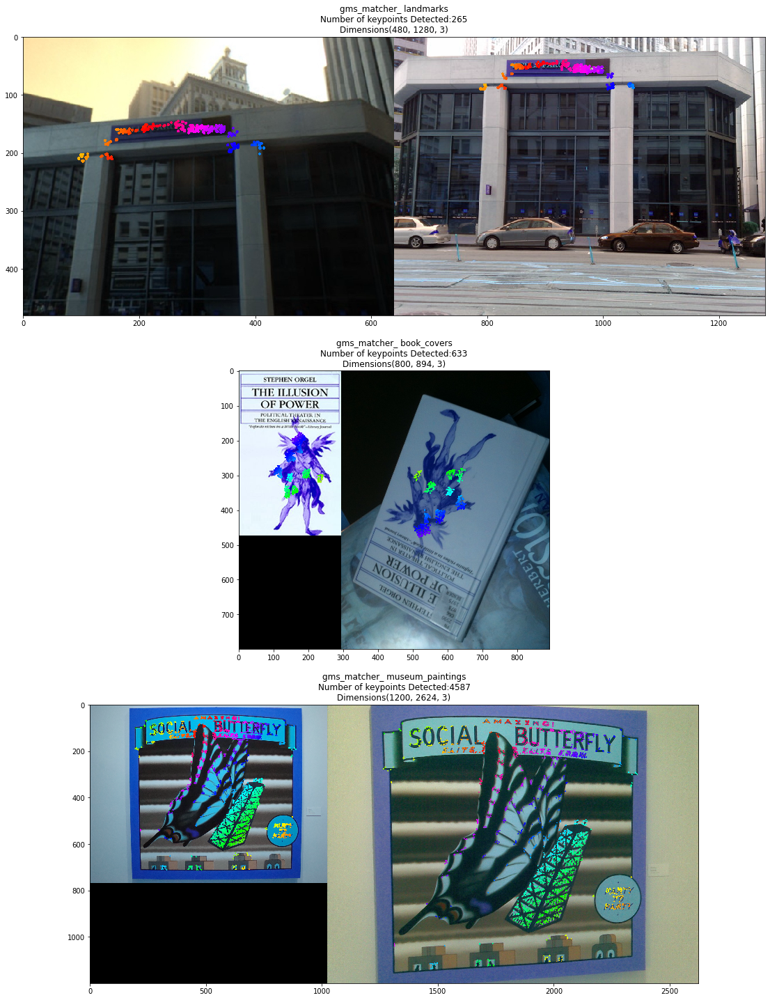

In [156]:
import math
from enum import Enum

import cv2
cv2.ocl.setUseOpenCL(False)

import numpy as np

THRESHOLD_FACTOR = 6

ROTATION_PATTERNS = [
    [1, 2, 3,
     4, 5, 6,
     7, 8, 9],

    [4, 1, 2,
     7, 5, 3,
     8, 9, 6],

    [7, 4, 1,
     8, 5, 2,
     9, 6, 3],

    [8, 7, 4,
     9, 5, 1,
     6, 3, 2],

    [9, 8, 7,
     6, 5, 4,
     3, 2, 1],

    [6, 9, 8,
     3, 5, 7,
     2, 1, 4],

    [3, 6, 9,
     2, 5, 8,
     1, 4, 7],

    [2, 3, 6,
     1, 5, 9,
     4, 7, 8]]

class Size:
    def __init__(self, width, height):
        self.width = width
        self.height = height

class DrawingType(Enum):
    ONLY_LINES = 1
    LINES_AND_POINTS = 2
    COLOR_CODED_POINTS_X = 3
    COLOR_CODED_POINTS_Y = 4
    COLOR_CODED_POINTS_XpY = 5


class GmsMatcher:
    def __init__(self, descriptor, matcher):
        self.scale_ratios = [1.0, 1.0 / 2, 1.0 / math.sqrt(2.0), math.sqrt(2.0), 2.0]
        # Normalized vectors of 2D points
        self.normalized_points1 = []
        self.normalized_points2 = []
        # Matches - list of pairs representing numbers
        self.matches = []
        self.matches_number = 0
        # Grid Size
        self.grid_size_right = Size(0, 0)
        self.grid_number_right = 0
        # x      : left grid idx
        # y      :  right grid idx
        # value  : how many matches from idx_left to idx_right
        self.motion_statistics = []

        self.number_of_points_per_cell_left = []
        # Inldex  : grid_idx_left
        # Value   : grid_idx_right
        self.cell_pairs = []

        # Every Matches has a cell-pair
        # first  : grid_idx_left
        # second : grid_idx_right
        self.match_pairs = []

        # Inlier Mask for output
        self.inlier_mask = []
        self.grid_neighbor_right = []

        # Grid initialize
        self.grid_size_left = Size(20, 20)
        self.grid_number_left = self.grid_size_left.width * self.grid_size_left.height

        # Initialize the neihbor of left grid
        self.grid_neighbor_left = np.zeros((self.grid_number_left, 9))

        self.descriptor = descriptor
        self.matcher = matcher
        self.gms_matches = []
        self.keypoints_image1 = []
        self.keypoints_image2 = []

    def empty_matches(self):
        self.normalized_points1 = []
        self.normalized_points2 = []
        self.matches = []
        self.gms_matches = []

    def compute_matches(self, img1, img2):
        self.keypoints_image1, descriptors_image1 = self.descriptor.detectAndCompute(img1, np.array([]))
        self.keypoints_image2, descriptors_image2 = self.descriptor.detectAndCompute(img2, np.array([]))
        size1 = Size(img1.shape[1], img1.shape[0])
        size2 = Size(img2.shape[1], img2.shape[0])

        if self.gms_matches:
            self.empty_matches()

        all_matches = self.matcher.match(descriptors_image1, descriptors_image2)
        self.normalize_points(self.keypoints_image1, size1, self.normalized_points1)
        self.normalize_points(self.keypoints_image2, size2, self.normalized_points2)
        self.matches_number = len(all_matches)
        self.convert_matches(all_matches, self.matches)
        self.initialize_neighbours(self.grid_neighbor_left, self.grid_size_left)

        mask, num_inliers = self.get_inlier_mask(False, False)
        print('Found', num_inliers, 'matches')

        for i in range(len(mask)):
            if mask[i]:
                self.gms_matches.append(all_matches[i])
        return self.gms_matches

    # Normalize Key points to range (0-1)
    def normalize_points(self, kp, size, npts):
        for keypoint in kp:
            npts.append((keypoint.pt[0] / size.width, keypoint.pt[1] / size.height))

    # Convert OpenCV match to list of tuples
    def convert_matches(self, vd_matches, v_matches):
        for match in vd_matches:
            v_matches.append((match.queryIdx, match.trainIdx))

    def initialize_neighbours(self, neighbor, grid_size):
        for i in range(neighbor.shape[0]):
            neighbor[i] = self.get_nb9(i, grid_size)

    def get_nb9(self, idx, grid_size):
        nb9 = [-1 for _ in range(9)]
        idx_x = idx % grid_size.width
        idx_y = idx // grid_size.width

        for yi in range(-1, 2):
            for xi in range(-1, 2):
                idx_xx = idx_x + xi
                idx_yy = idx_y + yi

                if idx_xx < 0 or idx_xx >= grid_size.width or idx_yy < 0 or idx_yy >= grid_size.height:
                    continue
                nb9[xi + 4 + yi * 3] = idx_xx + idx_yy * grid_size.width

        return nb9

    def get_inlier_mask(self, with_scale, with_rotation):
        max_inlier = 0
        self.set_scale(0)

        if not with_scale and not with_rotation:
            max_inlier = self.run(1)
            return self.inlier_mask, max_inlier
        elif with_scale and with_rotation:
            vb_inliers = []
            for scale in range(5):
                self.set_scale(scale)
                for rotation_type in range(1, 9):
                    num_inlier = self.run(rotation_type)
                    if num_inlier > max_inlier:
                        vb_inliers = self.inlier_mask
                        max_inlier = num_inlier

            if vb_inliers != []:
                return vb_inliers, max_inlier
            else:
                return self.inlier_mask, max_inlier
        elif with_rotation and not with_scale:
            vb_inliers = []
            for rotation_type in range(1, 9):
                num_inlier = self.run(rotation_type)
                if num_inlier > max_inlier:
                    vb_inliers = self.inlier_mask
                    max_inlier = num_inlier

            if vb_inliers != []:
                return vb_inliers, max_inlier
            else:
                return self.inlier_mask, max_inlier
        else:
            vb_inliers = []
            for scale in range(5):
                self.set_scale(scale)
                num_inlier = self.run(1)
                if num_inlier > max_inlier:
                    vb_inliers = self.inlier_mask
                    max_inlier = num_inlier

            if vb_inliers != []:
                return vb_inliers, max_inlier
            else:
                return self.inlier_mask, max_inlier

    def set_scale(self, scale):
        self.grid_size_right.width = self.grid_size_left.width * self.scale_ratios[scale]
        self.grid_size_right.height = self.grid_size_left.height * self.scale_ratios[scale]
        self.grid_number_right = self.grid_size_right.width * self.grid_size_right.height

        # Initialize the neighbour of right grid
        self.grid_neighbor_right = np.zeros((int(self.grid_number_right), 9))
        self.initialize_neighbours(self.grid_neighbor_right, self.grid_size_right)

    def run(self, rotation_type):
        self.inlier_mask = [False for _ in range(self.matches_number)]

        # Initialize motion statistics
        self.motion_statistics = np.zeros((int(self.grid_number_left), int(self.grid_number_right)))
        self.match_pairs = [[0, 0] for _ in range(self.matches_number)]

        for GridType in range(1, 5):
            self.motion_statistics = np.zeros((int(self.grid_number_left), int(self.grid_number_right)))
            self.cell_pairs = [-1 for _ in range(self.grid_number_left)]
            self.number_of_points_per_cell_left = [0 for _ in range(self.grid_number_left)]

            self.assign_match_pairs(GridType)
            self.verify_cell_pairs(rotation_type)

            # Mark inliers
            for i in range(self.matches_number):
                if self.cell_pairs[int(self.match_pairs[i][0])] == self.match_pairs[i][1]:
                    self.inlier_mask[i] = True

        return sum(self.inlier_mask)

    def assign_match_pairs(self, grid_type):
        for i in range(self.matches_number):
            lp = self.normalized_points1[self.matches[i][0]]
            rp = self.normalized_points2[self.matches[i][1]]
            lgidx = self.match_pairs[i][0] = self.get_grid_index_left(lp, grid_type)

            if grid_type == 1:
                rgidx = self.match_pairs[i][1] = self.get_grid_index_right(rp)
            else:
                rgidx = self.match_pairs[i][1]

            if lgidx < 0 or rgidx < 0:
                continue
            self.motion_statistics[int(lgidx)][int(rgidx)] += 1
            self.number_of_points_per_cell_left[int(lgidx)] += 1

    def get_grid_index_left(self, pt, type_of_grid):
        x = pt[0] * self.grid_size_left.width
        y = pt[1] * self.grid_size_left.height

        if type_of_grid == 2:
            x += 0.5
        elif type_of_grid == 3:
            y += 0.5
        elif type_of_grid == 4:
            x += 0.5
            y += 0.5

        x = math.floor(x)
        y = math.floor(y)

        if x >= self.grid_size_left.width or y >= self.grid_size_left.height:
            return -1
        return x + y * self.grid_size_left.width

    def get_grid_index_right(self, pt):
        x = int(math.floor(pt[0] * self.grid_size_right.width))
        y = int(math.floor(pt[1] * self.grid_size_right.height))
        return x + y * self.grid_size_right.width

    def verify_cell_pairs(self, rotation_type):
        current_rotation_pattern = ROTATION_PATTERNS[rotation_type - 1]

        for i in range(self.grid_number_left):
            if sum(self.motion_statistics[i]) == 0:
                self.cell_pairs[i] = -1
                continue
            max_number = 0
            for j in range(int(self.grid_number_right)):
                value = self.motion_statistics[i]
                if value[j] > max_number:
                    self.cell_pairs[i] = j
                    max_number = value[j]

            idx_grid_rt = self.cell_pairs[i]
            nb9_lt = self.grid_neighbor_left[i]
            nb9_rt = self.grid_neighbor_right[idx_grid_rt]
            score = 0
            thresh = 0
            numpair = 0

            for j in range(9):
                ll = nb9_lt[j]
                rr = nb9_rt[current_rotation_pattern[j] - 1]
                if ll == -1 or rr == -1:
                    continue

                score += self.motion_statistics[int(ll), int(rr)]
                thresh += self.number_of_points_per_cell_left[int(ll)]
                numpair += 1

            thresh = THRESHOLD_FACTOR * math.sqrt(thresh/numpair)
            if score < thresh:
                self.cell_pairs[i] = -2

    def draw_matches(self, src1, src2, drawing_type):
        height = max(src1.shape[0], src2.shape[0])
        width = src1.shape[1] + src2.shape[1]
        output = np.zeros((height, width, 3), dtype=np.uint8)
        output[0:src1.shape[0], 0:src1.shape[1]] = src1
        output[0:src2.shape[0], src1.shape[1]:] = src2[:]

        if drawing_type == DrawingType.ONLY_LINES:
            for i in range(len(self.gms_matches)):
                left = self.keypoints_image1[self.gms_matches[i].queryIdx].pt
                right = tuple(sum(x) for x in zip(self.keypoints_image2[self.gms_matches[i].trainIdx].pt, (src1.shape[1], 0)))
                cv2.line(output, tuple(map(int, left)), tuple(map(int, right)), (0, 255, 255))

        elif drawing_type == DrawingType.LINES_AND_POINTS:
            for i in range(len(self.gms_matches)):
                left = self.keypoints_image1[self.gms_matches[i].queryIdx].pt
                right = tuple(sum(x) for x in zip(self.keypoints_image2[self.gms_matches[i].trainIdx].pt, (src1.shape[1], 0)))
                cv2.line(output, tuple(map(int, left)), tuple(map(int, right)), (255, 0, 0))

            for i in range(len(self.gms_matches)):
                left = self.keypoints_image1[self.gms_matches[i].queryIdx].pt
                right = tuple(sum(x) for x in zip(self.keypoints_image2[self.gms_matches[i].trainIdx].pt, (src1.shape[1], 0)))
                cv2.circle(output, tuple(map(int, left)), 1, (0, 255, 255), 2)
                cv2.circle(output, tuple(map(int, right)), 1, (0, 255, 0), 2)

        elif drawing_type == DrawingType.COLOR_CODED_POINTS_X or drawing_type == DrawingType.COLOR_CODED_POINTS_Y or drawing_type == DrawingType.COLOR_CODED_POINTS_XpY :
            _1_255 = np.expand_dims( np.array( range( 0, 256 ), dtype='uint8' ), 1 )
            _colormap = cv2.applyColorMap(_1_255, cv2.COLORMAP_HSV)

            for i in range(len(self.gms_matches)):
                left = self.keypoints_image1[self.gms_matches[i].queryIdx].pt
                right = tuple(sum(x) for x in zip(self.keypoints_image2[self.gms_matches[i].trainIdx].pt, (src1.shape[1], 0)))

                if drawing_type == DrawingType.COLOR_CODED_POINTS_X:
                    colormap_idx = int(left[0] * 256. / src1.shape[1] ) # x-gradient
                if drawing_type == DrawingType.COLOR_CODED_POINTS_Y:
                    colormap_idx = int(left[1] * 256. / src1.shape[0] ) # y-gradient
                if drawing_type == DrawingType.COLOR_CODED_POINTS_XpY:
                    colormap_idx = int( (left[0] - src1.shape[1]*.5 + left[1] - src1.shape[0]*.5) * 256. / (src1.shape[0]*.5 + src1.shape[1]*.5) ) # manhattan gradient

                color = tuple( map(int, _colormap[ colormap_idx,0,: ]) )
                cv2.circle(output, tuple(map(int, left)), 1, color, 2)
                cv2.circle(output, tuple(map(int, right)), 1, color, 2)


        return output

result = []
if __name__ == '__main__':

    img1 = cv2.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/landmarks/Reference/0000.jpg")
    img2 = cv2.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/landmarks/Query/0000.jpg")

    orb = cv2.ORB_create(10000)
    orb.setFastThreshold(0)
    if cv2.__version__.startswith('3'):
        matcher = cv2.BFMatcher(cv2.NORM_HAMMING)
    else:
        matcher = cv2.BFMatcher_create(cv2.NORM_HAMMING)
    gms = GmsMatcher(orb, matcher)

    matches = gms.compute_matches(img1, img2)
    # gms.draw_matches(img1, img2, DrawingType.ONLY_LINES)
    image = gms.draw_matches(img1, img2, DrawingType.COLOR_CODED_POINTS_XpY)
    result.append([image, "gms_matcher_ landmarks", matches])


if __name__ == '__main__':


    img1 = cv2.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/book_covers/Reference/019.jpg")
    img2 = cv2.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/book_covers/Query/019.jpg")

    
    orb = cv2.ORB_create(10000)
    orb.setFastThreshold(0)
    if cv2.__version__.startswith('3'):
        matcher = cv2.BFMatcher(cv2.NORM_HAMMING)
    else:
        matcher = cv2.BFMatcher_create(cv2.NORM_HAMMING)
    gms = GmsMatcher(orb, matcher)

    matches = gms.compute_matches(img1, img2)
    # gms.draw_matches(img1, img2, DrawingType.ONLY_LINES)
    image = gms.draw_matches(img1, img2, DrawingType.COLOR_CODED_POINTS_XpY)
    result.append([image, "gms_matcher_ book_covers", matches])
if __name__ == '__main__':

    img1 = cv2.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/museum_paintings/Reference/018.jpg")
    img2 = cv2.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/museum_paintings/Query/018.jpg")
    
    orb = cv2.ORB_create(10000)
    orb.setFastThreshold(0)
    if cv2.__version__.startswith('3'):
        matcher = cv2.BFMatcher(cv2.NORM_HAMMING)
    else:
        matcher = cv2.BFMatcher_create(cv2.NORM_HAMMING)
    gms = GmsMatcher(orb, matcher)

    matches = gms.compute_matches(img1, img2)

    # gms.draw_matches(img1, img2, DrawingType.ONLY_LINES)
    image = gms.draw_matches(img1, img2, DrawingType.COLOR_CODED_POINTS_XpY)
    result.append([image, "gms_matcher_ museum_paintings", matches])

    display_all(result, 25, 3, 1)




Found 270 matches
GMS takes 0.0031027793884277344 seconds
Found 339 matches
GMS takes 0.002628326416015625 seconds
Found 4196 matches
GMS takes 0.003221750259399414 seconds


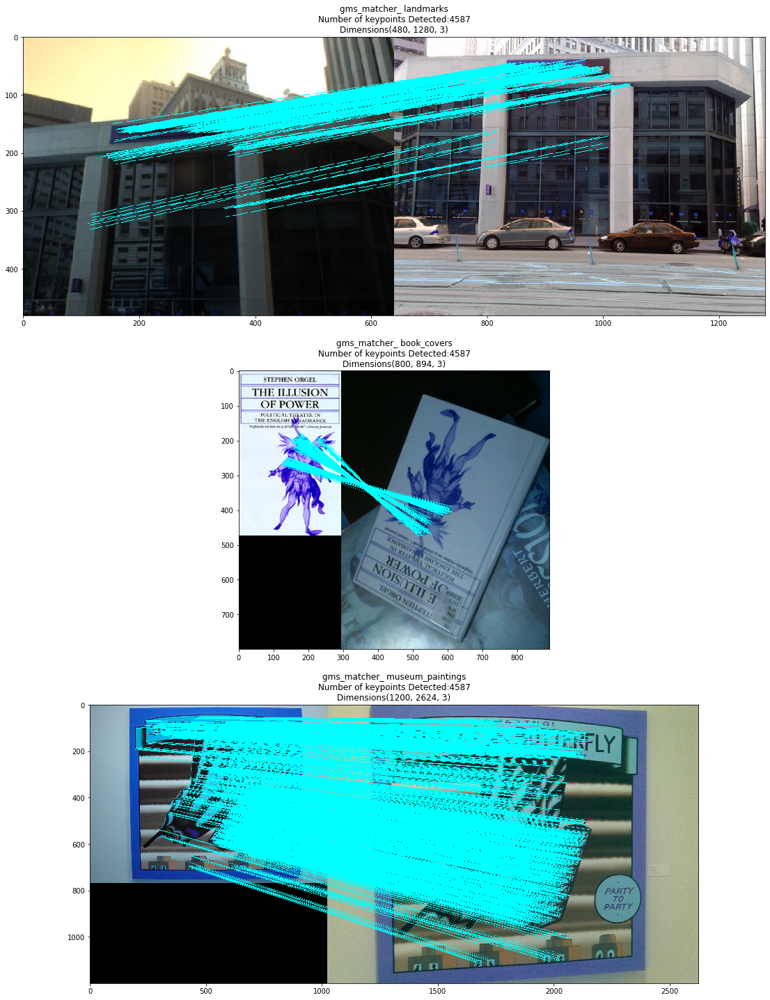

In [157]:
import numpy as np
from enum import Enum
import time
import cv2
from cv2.xfeatures2d import matchGMS


class DrawingType(Enum):
    ONLY_LINES = 1
    LINES_AND_POINTS = 2
    COLOR_CODED_POINTS_X = 3
    COLOR_CODED_POINTS_Y = 4
    COLOR_CODED_POINTS_XpY = 5


def draw_matches(src1, src2, kp1, kp2, matches, drawing_type):
    height = max(src1.shape[0], src2.shape[0])
    width = src1.shape[1] + src2.shape[1]
    output = np.zeros((height, width, 3), dtype=np.uint8)
    output[0:src1.shape[0], 0:src1.shape[1]] = src1
    output[0:src2.shape[0], src1.shape[1]:] = src2[:]

    if drawing_type == DrawingType.ONLY_LINES:
        for i in range(len(matches)):
            left = kp1[matches[i].queryIdx].pt
            right = tuple(sum(x) for x in zip(kp2[matches[i].trainIdx].pt, (src1.shape[1], 0)))
            cv2.line(output, tuple(map(int, left)), tuple(map(int, right)), (0, 255, 255))

    elif drawing_type == DrawingType.LINES_AND_POINTS:
        for i in range(len(matches)):
            left = kp1[matches[i].queryIdx].pt
            right = tuple(sum(x) for x in zip(kp2[matches[i].trainIdx].pt, (src1.shape[1], 0)))
            cv2.line(output, tuple(map(int, left)), tuple(map(int, right)), (255, 0, 0))

        for i in range(len(matches)):
            left = kp1[matches[i].queryIdx].pt
            right = tuple(sum(x) for x in zip(kp2[matches[i].trainIdx].pt, (src1.shape[1], 0)))
            cv2.circle(output, tuple(map(int, left)), 1, (0, 255, 255), 2)
            cv2.circle(output, tuple(map(int, right)), 1, (0, 255, 0), 2)

    elif drawing_type == DrawingType.COLOR_CODED_POINTS_X or drawing_type == DrawingType.COLOR_CODED_POINTS_Y or drawing_type == DrawingType.COLOR_CODED_POINTS_XpY:
        _1_255 = np.expand_dims(np.array(range(0, 256), dtype='uint8'), 1)
        _colormap = cv2.applyColorMap(_1_255, cv2.COLORMAP_HSV)

        for i in range(len(matches)):
            left = kp1[matches[i].queryIdx].pt
            right = tuple(sum(x) for x in zip(kp2[matches[i].trainIdx].pt, (src1.shape[1], 0)))

            if drawing_type == DrawingType.COLOR_CODED_POINTS_X:
                colormap_idx = int(left[0] * 256. / src1.shape[1])  # x-gradient
            if drawing_type == DrawingType.COLOR_CODED_POINTS_Y:
                colormap_idx = int(left[1] * 256. / src1.shape[0])  # y-gradient
            if drawing_type == DrawingType.COLOR_CODED_POINTS_XpY:
                colormap_idx = int((left[0] - src1.shape[1]*.5 + left[1] - src1.shape[0]*.5) * 256. / (src1.shape[0]*.5 + src1.shape[1]*.5))  # manhattan gradient

            color = tuple(map(int, _colormap[colormap_idx, 0, :]))
            cv2.circle(output, tuple(map(int, left)), 1, color, 2)
            cv2.circle(output, tuple(map(int, right)), 1, color, 2)
    return output


result = []
if __name__ == '__main__':
    img1 = cv2.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/landmarks/Reference/0000.jpg")
    img2 = cv2.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/landmarks/Query/0000.jpg")

    orb = cv2.ORB_create(10000)
    orb.setFastThreshold(0)

    kp1, des1 = orb.detectAndCompute(img1, None)
    kp2, des2 = orb.detectAndCompute(img2, None)
    matcher = cv2.BFMatcher(cv2.NORM_HAMMING)
    matches_all = matcher.match(des1, des2)

    start = time.time()
    matches_gms = matchGMS(img1.shape[:2], img2.shape[:2], kp1, kp2, matches_all, withScale=False, withRotation=False, thresholdFactor=6)
    end = time.time()

    print('Found', len(matches_gms), 'matches')
    print('GMS takes', end-start, 'seconds')

    output = draw_matches(img1, img2, kp1, kp2, matches_gms, DrawingType.ONLY_LINES)

    result.append([output, "gms_matcher_ landmarks", matches])

if __name__ == '__main__':
    img1 = cv2.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/book_covers/Reference/019.jpg")
    img2 = cv2.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/book_covers/Query/019.jpg")

    orb = cv2.ORB_create(10000)
    orb.setFastThreshold(0)

    kp1, des1 = orb.detectAndCompute(img1, None)
    kp2, des2 = orb.detectAndCompute(img2, None)
    matcher = cv2.BFMatcher(cv2.NORM_HAMMING)
    matches_all = matcher.match(des1, des2)

    start = time.time()
    matches_gms = matchGMS(img1.shape[:2], img2.shape[:2], kp1, kp2, matches_all, withScale=False, withRotation=False, thresholdFactor=6)
    end = time.time()

    print('Found', len(matches_gms), 'matches')
    print('GMS takes', end-start, 'seconds')

    output = draw_matches(img1, img2, kp1, kp2, matches_gms, DrawingType.ONLY_LINES)

    result.append([output, "gms_matcher_ book_covers", matches])


if __name__ == '__main__':
    img1 = cv2.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/museum_paintings/Reference/018.jpg")
    img2 = cv2.imread("/content/drive/MyDrive/CV_Colab/CV Assignment 2/A2_smvs/museum_paintings/Query/018.jpg")

    orb = cv2.ORB_create(10000)
    orb.setFastThreshold(0)

    kp1, des1 = orb.detectAndCompute(img1, None)
    kp2, des2 = orb.detectAndCompute(img2, None)
    matcher = cv2.BFMatcher(cv2.NORM_HAMMING)
    matches_all = matcher.match(des1, des2)

    start = time.time()
    matches_gms = matchGMS(img1.shape[:2], img2.shape[:2], kp1, kp2, matches_all, withScale=False, withRotation=False, thresholdFactor=6)
    end = time.time()

    print('Found', len(matches_gms), 'matches')
    print('GMS takes', end-start, 'seconds')

    output = draw_matches(img1, img2, kp1, kp2, matches_gms, DrawingType.ONLY_LINES)

    result.append([output, "gms_matcher_ museum_paintings", matches])

    display_all(result, 25, 3, 1)

***Your results here***

The existing methods like ORB and SIFT take a long computational time, limiting their use in real-time applications. The above method attempts to separate true correspondences from false ones at high speed. The method (GMS) grid-based motion Statistics, incorporates the smoothness constraint into a statistic framework for separation and uses a grid-based implementation for fast calculation. GMS is robust to various challenging image changes, involving viewpoint, scale, and rotation. It is also fast, e.g., takes only 1 or 2 ms in a single CPU thread, even when 50K correspondences are processed. This has important implications for real-time applications. 

# Question 4: Reflection Questions (5%)

1. Describe the hardest situation you faced during the first two assignments. And how you overcome it? (3%)


2. How do you plan to finish the assignment to meet tight deadline? (2%)

1. The hardest situation I faced during the first two assignments is I was not sure how to implement the knowledge I learned from lectures or workshops into the Assignment. Often, I could understand the concepts of the course materials, but to convey the concepts and actually use them to implement an algorithm can be very tricky. To overcome this, I've done a lot of research online and read some papers that are related to the question in the assignment. Moreover, I frequently ask Yifan and other tutors questions and gain many insightful feedbacks from them. This helped me a lot with my assignment.

2. I tend to finish the assignment as soon as I can. If I faced some problems that I cannot overcome, I would ask the tutor for assistance. If the problem is not related to the rest of the question, I can hold the problem and continue the rest of the assignment first, and finally come back to the problem. This way, I can finish the assignment to meet a tight deadline. 